# 교체 알고리즘 별 성능 비교 분석

다양한 입력 형태에 따른, 교체 알고리즘의 성능 분석 결과를 도표로 작성

#### 비교 기준
- 가능한 데이터 개수
- 입력 패턴
- 슬롯 개수 

으로 적중률과 수행시간 비교 

## 1. 함수 설명
### 필요한 라이브러리

In [122]:
import LRU, FIFO, LFU, RND 
from random import * 
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import pandas as pd
from datetime import datetime

### 적중률 데이터 가져오는 함수 + 수행시간 가져오는 함수

#### Parameter 설명 
- input_size : 가능한 데이터 개수 
- input_max_value : 입력 패턴 0 ~ input_max_value사이의 난수
- slot_size : 슬롯 개수 

In [154]:
def get_hit_result(input_size, input_max_size, slot_max_size):
    LRU_list = []
    LFU_list = []
    RND_list = []
    FIFO_list = []

    for slot_size in range(3, slot_max_size):

        tmp_LRU = 0
        tmp_LFU = 0
        tmp_RND = 0
        tmp_FIFO = 0
        for i in range(10):

            input_list = []

            for j in range(input_size):
                input_list.append(randint(0, input_max_value))

            tmp_LRU += LRU.LRU_implement(input_list, slot_size)
            tmp_LFU += LFU.LFU_implement(input_list, slot_size)
            tmp_RND += RND.Random_implement(input_list, slot_size)
            tmp_FIFO += FIFO.FIFO_implement(input_list, slot_size)

        LRU_list.append(tmp_LRU / 10)
        LFU_list.append(tmp_LFU / 10)
        RND_list.append(tmp_RND / 10)
        FIFO_list.append(tmp_FIFO / 10)
        
    #index = [i for i in range(3,slot_max_size)]
    #index = np.array(index)

    return LRU_list, LFU_list, RND_list, FIFO_list

In [155]:
def get_time_result(input_size, input_max_size, slot_max_size):
    LRU_list = []
    LFU_list = []
    RND_list = []
    FIFO_list = []

    for n in range(3, slot_max_size):

        time_LRU = 0
        time_LFU = 0
        time_RND = 0
        time_FIFO = 0
        for i in range(10):

            input_list = []

            for j in range(input_size):
                input_list.append(randint(0, input_max_value))

            starttime = datetime.now()
            LRU.LRU_implement(input_list, slot_size)
            tmpTime_LRU = (datetime.now()-starttime).microseconds

            starttime = datetime.now()
            LFU.LFU_implement(input_list, slot_size)
            tmpTime_LFU = (datetime.now()-starttime).microseconds

            starttime = datetime.now()
            RND.Random_implement(input_list, slot_size)
            tmpTime_FIFO = (datetime.now()-starttime).microseconds

            starttime = datetime.now()
            FIFO.FIFO_implement(input_list, slot_size)
            tmpTime_RND = (datetime.now()-starttime).microseconds

            time_LRU += tmpTime_LRU
            time_LFU += tmpTime_LFU
            time_RND += tmpTime_RND
            time_FIFO += tmpTime_FIFO

        LRU_list.append(time_LRU / 10)
        LFU_list.append(time_LFU / 10)
        RND_list.append(time_RND / 10)
        FIFO_list.append(time_FIFO / 10)
    
    #index = [i for i in range(3,slot_max_size)]
    #index = np.array(index)

    return LRU_list, LFU_list, RND_list, FIFO_list

### 도표 작성하는 함수 

In [156]:
def visualize(input_size, input_max_size):
    
    fig = plt.figure(figsize = (11,20))
    gs = gridspec.GridSpec(4,2)
    
    slot_list = [25,50,75,100]
    
    for i,slot_size in zip(range(4), slot_list):
        
        LRU_list, LFU_list, RND_list, FIFO_list = get_hit_result(input_size, input_max_size, slot_size)
        LRU_tlist, LFU_tlist, RND_tlist, FIFO_tlist = get_time_result(input_size, input_max_size, slot_size)
        
        index = ['LRU', 'LFU', 'RND', 'FIFO']
        columns = [i for i in range(3,slot_size)]

        ax1 = fig.add_subplot(gs[i,0])
        plt.plot(columns, LRU_list, label = 'LRU')
        plt.plot(columns, LFU_list, label = 'LFU')
        plt.plot(columns, FIFO_list, label = 'FIFO')
        plt.plot(columns, RND_list, label = 'RND')
        plt.scatter(columns, LRU_list)
        plt.scatter(columns, LFU_list)
        plt.scatter(columns, RND_list)
        plt.scatter(columns, FIFO_list)
        plt.title("Slot Size : " + str(slot_size))
        plt.ylabel("HIT Ratio")
        plt.xlabel("Slot Size")
        plt.legend(loc='best')

        ax2 = fig.add_subplot(gs[i,1])
        plt.plot(columns, LRU_tlist, label = 'LRU')
        plt.plot(columns, LFU_tlist, label = 'LFU')
        plt.plot(columns, FIFO_tlist, label = 'FIFO')
        plt.plot(columns, RND_tlist, label = 'RND')
        plt.scatter(columns, LRU_tlist)
        plt.scatter(columns, LFU_tlist)
        plt.scatter(columns, FIFO_tlist)
        plt.scatter(columns, RND_tlist)
        plt.title("Slot Size : " + str(slot_size))
        plt.ylabel("Excution Time")
        plt.xlabel("Slot Size")
        plt.legend(loc='best')
    plt.show()

## 2. 알고리즘 별 비교
### 2.1 가능한 입력 수가 25일 때
#### 2.1.1 난수의 최대 수가 25일 때
슬롯 사이즈를 25,50,75,100으로 주어 적중률과 수행시간 비교


LRU : 
Round #1 -> [24] 현재 캐쉬 상태 : [(24, 0)]
Round #2 -> [15] 현재 캐쉬 상태 : [(24, 1), (15, 0)]
Round #3 -> [5] 현재 캐쉬 상태 : [(24, 2), (15, 1), (5, 0)]
Round #4 -> [3] 현재 캐쉬 상태 : [(3, 0), (15, 2), (5, 1)]
Round #5 -> [7] 현재 캐쉬 상태 : [(3, 1), (7, 0), (5, 2)]
Round #6 -> [9] 현재 캐쉬 상태 : [(3, 2), (7, 1), (9, 0)]
Round #7 -> [13] 현재 캐쉬 상태 : [(13, 0), (7, 2), (9, 1)]
Round #8 -> [6] 현재 캐쉬 상태 : [(13, 1), (6, 0), (9, 2)]
Round #9 -> [5] 현재 캐쉬 상태 : [(13, 2), (6, 1), (5, 0)]
Round #10 -> [22] 현재 캐쉬 상태 : [(22, 0), (6, 2), (5, 1)]
Round #11 -> [12] 현재 캐쉬 상태 : [(22, 1), (12, 0), (5, 2)]
Round #12 -> [22] 현재 캐쉬 상태 : [(22, 0), (12, 1), (5, 3)], HIT!!
Round #13 -> [24] 현재 캐쉬 상태 : [(22, 1), (12, 2), (24, 0)]
Round #14 -> [6] 현재 캐쉬 상태 : [(22, 2), (6, 0), (24, 1)]
Round #15 -> [15] 현재 캐쉬 상태 : [(15, 0), (6, 1), (24, 2)]
Round #16 -> [20] 현재 캐쉬 상태 : [(15, 1), (6, 2), (20, 0)]
Round #17 -> [21] 현재 캐쉬 상태 : [(15, 2), (21, 0), (20, 1)]
Round #18 -> [0] 현재 캐쉬 상태 : [(0, 0), (21, 1), (20, 2)]
Round #19 -> [3] 현재 캐쉬 상태 

Round #16 -> [2] 현재 캐쉬 상태 : [(0, 2), (10, 1), (17, 5), (2, 0), (23, 4), (21, 3)]
Round #17 -> [2] 현재 캐쉬 상태 : [(0, 3), (10, 2), (17, 6), (2, 0), (23, 5), (21, 4)], HIT!!
Round #18 -> [2] 현재 캐쉬 상태 : [(0, 4), (10, 3), (17, 7), (2, 0), (23, 6), (21, 5)], HIT!!
Round #19 -> [11] 현재 캐쉬 상태 : [(0, 5), (10, 4), (11, 0), (2, 1), (23, 7), (21, 6)]
Round #20 -> [2] 현재 캐쉬 상태 : [(0, 6), (10, 5), (11, 1), (2, 0), (23, 8), (21, 7)], HIT!!
Round #21 -> [10] 현재 캐쉬 상태 : [(0, 7), (10, 0), (11, 2), (2, 1), (23, 9), (21, 8)], HIT!!
Round #22 -> [0] 현재 캐쉬 상태 : [(0, 0), (10, 1), (11, 3), (2, 2), (23, 10), (21, 9)], HIT!!
Round #23 -> [2] 현재 캐쉬 상태 : [(0, 1), (10, 2), (11, 4), (2, 0), (23, 11), (21, 10)], HIT!!
Round #24 -> [23] 현재 캐쉬 상태 : [(0, 2), (10, 3), (11, 5), (2, 1), (23, 0), (21, 11)], HIT!!
Round #25 -> [6] 현재 캐쉬 상태 : [(0, 3), (10, 4), (11, 6), (2, 2), (23, 1), (6, 0)]
H = 8 / 25 = 0.32

LFU : 
Round#1 -> [23] 현재 캐쉬 상태 : [(23, 1)]
Round#2 -> [12] 현재 캐쉬 상태 : [(23, 1), (12, 1)]
Round#3 -> [16] 현재 캐쉬 상태 :

Round #8 -> [19] 현재 캐쉬 상태 : [0, 23, 21, 15, 1, 19]
Round #9 -> [19] 현재 캐쉬 상태 : [0, 23, 21, 15, 1, 19], HIT!!
Round #10 -> [12] 현재 캐쉬 상태 : [0, 23, 21, 15, 1, 19, 12]
Round #11 -> [11] 현재 캐쉬 상태 : [0, 23, 21, 15, 1, 19, 12, 11]
Round #12 -> [10] 현재 캐쉬 상태 : [10, 23, 21, 15, 1, 19, 12, 11]
Round #13 -> [14] 현재 캐쉬 상태 : [10, 14, 21, 15, 1, 19, 12, 11]
Round #14 -> [13] 현재 캐쉬 상태 : [10, 14, 13, 15, 1, 19, 12, 11]
Round #15 -> [19] 현재 캐쉬 상태 : [10, 14, 13, 15, 1, 19, 12, 11], HIT!!
Round #16 -> [3] 현재 캐쉬 상태 : [10, 14, 13, 3, 1, 19, 12, 11]
Round #17 -> [3] 현재 캐쉬 상태 : [10, 14, 13, 3, 1, 19, 12, 11], HIT!!
Round #18 -> [9] 현재 캐쉬 상태 : [10, 14, 13, 3, 9, 19, 12, 11]
Round #19 -> [25] 현재 캐쉬 상태 : [10, 14, 13, 3, 9, 25, 12, 11]
Round #20 -> [17] 현재 캐쉬 상태 : [10, 14, 13, 3, 9, 25, 17, 11]
Round #21 -> [6] 현재 캐쉬 상태 : [10, 14, 13, 3, 9, 25, 17, 6]
Round #22 -> [0] 현재 캐쉬 상태 : [0, 14, 13, 3, 9, 25, 17, 6]
Round #23 -> [19] 현재 캐쉬 상태 : [0, 19, 13, 3, 9, 25, 17, 6]
Round #24 -> [20] 현재 캐쉬 상태 : [0, 19, 20, 3, 9, 

Round #3 -> [13] 현재 캐쉬 상태 : [7, 10, 13]
Round #4 -> [4] 현재 캐쉬 상태 : [7, 10, 13, 4]
Round #5 -> [21] 현재 캐쉬 상태 : [7, 10, 13, 4, 21]
Round #6 -> [6] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6]
Round #7 -> [14] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14]
Round #8 -> [10] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14], HIT!!
Round #9 -> [15] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15]
Round #10 -> [7] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15], HIT!!
Round #11 -> [21] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15], HIT!!
Round #12 -> [18] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18]
Round #13 -> [24] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24]
Round #14 -> [24] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24], HIT!!
Round #15 -> [2] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24, 2]
Round #16 -> [21] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24, 2], HIT!!
Round #17 -> [24] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24, 2], HIT!!
Round #18 -> [18] 현재 캐쉬 상태 : [7, 10, 13, 4, 21, 6, 14, 15, 18, 24, 2], HIT!!
Round #19 -> [

Round #19 -> [1] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22, 4, 0, 6, 1, 11, 10]
Round #20 -> [23] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22, 4, 0, 6, 1, 11, 23]
Round #21 -> [25] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22, 4, 0, 6, 1, 11, 25]
Round #22 -> [4] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22, 4, 0, 6, 1, 11, 25], HIT!!
Round #23 -> [15] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 15, 22, 4, 0, 6, 1, 11, 25]
Round #24 -> [9] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 15, 22, 4, 0, 6, 1, 11, 25], HIT!!
Round #25 -> [10] 현재 캐쉬 상태 : [24, 10, 12, 21, 9, 15, 22, 4, 0, 6, 1, 11, 25]
H = 7 / 25 = 0.28

FIFO : 
Round #1 -> [24] 현재 캐쉬 상태 : [24]
Round #2 -> [8] 현재 캐쉬 상태 : [24, 8]
Round #3 -> [12] 현재 캐쉬 상태 : [24, 8, 12]
Round #4 -> [21] 현재 캐쉬 상태 : [24, 8, 12, 21]
Round #5 -> [9] 현재 캐쉬 상태 : [24, 8, 12, 21, 9]
Round #6 -> [9] 현재 캐쉬 상태 : [24, 8, 12, 21, 9], HIT!!
Round #7 -> [13] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13]
Round #8 -> [22] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22]
Round #9 -> [4] 현재 캐쉬 상태 : [24, 8, 12, 21, 9, 13, 22, 4]
Round #10 -> [0

Round #1 -> [15] 현재 캐쉬 상태 : [15]
Round #2 -> [6] 현재 캐쉬 상태 : [15, 6]
Round #3 -> [15] 현재 캐쉬 상태 : [15, 6], HIT!!
Round #4 -> [5] 현재 캐쉬 상태 : [15, 6, 5]
Round #5 -> [6] 현재 캐쉬 상태 : [15, 6, 5], HIT!!
Round #6 -> [24] 현재 캐쉬 상태 : [15, 6, 5, 24]
Round #7 -> [23] 현재 캐쉬 상태 : [15, 6, 5, 24, 23]
Round #8 -> [14] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14]
Round #9 -> [5] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14], HIT!!
Round #10 -> [10] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10]
Round #11 -> [4] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4]
Round #12 -> [11] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11]
Round #13 -> [1] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1]
Round #14 -> [19] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1, 19]
Round #15 -> [19] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1, 19], HIT!!
Round #16 -> [1] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1, 19], HIT!!
Round #17 -> [21] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1, 19, 21]
Round #18 -> [2] 현재 캐쉬 상태 : [15, 6, 5, 24, 23, 14, 10, 4, 11, 1, 19, 

Round#5 -> [24] 현재 캐쉬 상태 : [(6, 1), (23, 1), (18, 1), (9, 1), (24, 1)]
Round#6 -> [20] 현재 캐쉬 상태 : [(6, 1), (23, 1), (18, 1), (9, 1), (24, 1), (20, 1)]
Round#7 -> [21] 현재 캐쉬 상태 : [(6, 1), (23, 1), (18, 1), (9, 1), (24, 1), (20, 1), (21, 1)]
Round#8 -> [23] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (23, 2), (24, 1), (20, 1), (21, 1)], HIT!!
Round#9 -> [7] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (24, 1), (20, 1), (21, 1), (23, 2)]
Round#10 -> [10] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (24, 1), (20, 1), (21, 1), (23, 2), (10, 1)]
Round#11 -> [11] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (24, 1), (20, 1), (21, 1), (23, 2), (10, 1), (11, 1)]
Round#12 -> [3] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (24, 1), (20, 1), (21, 1), (23, 2), (10, 1), (11, 1), (3, 1)]
Round#13 -> [16] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (24, 1), (20, 1), (21, 1), (23, 2), (10, 1), (11, 1), (3, 1), (16, 1)]
Round#14 -> [24] 현재 캐쉬 상태 : [(6, 1), (9, 1), (18, 1), (7, 1), (11, 1), (20, 1), (21, 1), 

Round #9 -> [14] 현재 캐쉬 상태 : [(4, 8), (19, 7), (20, 6), (13, 5), (6, 4), (0, 3), (9, 2), (22, 1), (14, 0)]
Round #10 -> [7] 현재 캐쉬 상태 : [(4, 9), (19, 8), (20, 7), (13, 6), (6, 5), (0, 4), (9, 3), (22, 2), (14, 1), (7, 0)]
Round #11 -> [15] 현재 캐쉬 상태 : [(4, 10), (19, 9), (20, 8), (13, 7), (6, 6), (0, 5), (9, 4), (22, 3), (14, 2), (7, 1), (15, 0)]
Round #12 -> [23] 현재 캐쉬 상태 : [(4, 11), (19, 10), (20, 9), (13, 8), (6, 7), (0, 6), (9, 5), (22, 4), (14, 3), (7, 2), (15, 1), (23, 0)]
Round #13 -> [24] 현재 캐쉬 상태 : [(4, 12), (19, 11), (20, 10), (13, 9), (6, 8), (0, 7), (9, 6), (22, 5), (14, 4), (7, 3), (15, 2), (23, 1), (24, 0)]
Round #14 -> [22] 현재 캐쉬 상태 : [(4, 13), (19, 12), (20, 11), (13, 10), (6, 9), (0, 8), (9, 7), (22, 0), (14, 5), (7, 4), (15, 3), (23, 2), (24, 1)], HIT!!
Round #15 -> [25] 현재 캐쉬 상태 : [(4, 14), (19, 13), (20, 12), (13, 11), (6, 10), (0, 9), (9, 8), (22, 1), (14, 6), (7, 5), (15, 4), (23, 3), (24, 2), (25, 0)]
Round #16 -> [23] 현재 캐쉬 상태 : [(4, 15), (19, 14), (20, 13), (13, 12

Round#3 -> [13] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1)]
Round#4 -> [5] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1), (5, 1)]
Round#5 -> [11] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1), (5, 1), (11, 1)]
Round#6 -> [3] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1), (5, 1), (11, 1), (3, 1)]
Round#7 -> [21] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1), (5, 1), (11, 1), (3, 1), (21, 1)]
Round#8 -> [14] 현재 캐쉬 상태 : [(1, 1), (2, 1), (13, 1), (5, 1), (11, 1), (3, 1), (21, 1), (14, 1)]
Round#9 -> [1] 현재 캐쉬 상태 : [(2, 1), (5, 1), (13, 1), (14, 1), (11, 1), (3, 1), (21, 1), (1, 2)], HIT!!
Round#10 -> [5] 현재 캐쉬 상태 : [(2, 1), (11, 1), (13, 1), (14, 1), (5, 2), (3, 1), (21, 1), (1, 2)], HIT!!
Round#11 -> [8] 현재 캐쉬 상태 : [(2, 1), (11, 1), (13, 1), (14, 1), (5, 2), (3, 1), (21, 1), (1, 2), (8, 1)]
Round#12 -> [11] 현재 캐쉬 상태 : [(2, 1), (14, 1), (13, 1), (8, 1), (5, 2), (3, 1), (21, 1), (1, 2), (11, 2)], HIT!!
Round#13 -> [12] 현재 캐쉬 상태 : [(2, 1), (14, 1), (13, 1), (8, 1), (12, 1), (3, 1), (21, 1), (1, 2), (11, 2), (5, 2)]
Round#14 -> [16] 현재 캐쉬

Round #8 -> [22] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18], HIT!!
Round #9 -> [2] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2]
Round #10 -> [14] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14]
Round #11 -> [9] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9]
Round #12 -> [9] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9], HIT!!
Round #13 -> [13] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13]
Round #14 -> [8] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8]
Round #15 -> [8] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8], HIT!!
Round #16 -> [7] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7]
Round #17 -> [20] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7, 20]
Round #18 -> [4] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7, 20, 4]
Round #19 -> [5] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7, 20, 4], HIT!!
Round #20 -> [13] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7, 20, 4], HIT!!
Round #21 -> [18] 현재 캐쉬 상태 : [15, 5, 10, 24, 22, 18, 2, 14, 9, 13, 8, 7, 20, 4], HI

LRU : 
Round #1 -> [1] 현재 캐쉬 상태 : [(1, 0)]
Round #2 -> [18] 현재 캐쉬 상태 : [(1, 1), (18, 0)]
Round #3 -> [9] 현재 캐쉬 상태 : [(1, 2), (18, 1), (9, 0)]
Round #4 -> [24] 현재 캐쉬 상태 : [(1, 3), (18, 2), (9, 1), (24, 0)]
Round #5 -> [15] 현재 캐쉬 상태 : [(1, 4), (18, 3), (9, 2), (24, 1), (15, 0)]
Round #6 -> [14] 현재 캐쉬 상태 : [(1, 5), (18, 4), (9, 3), (24, 2), (15, 1), (14, 0)]
Round #7 -> [10] 현재 캐쉬 상태 : [(1, 6), (18, 5), (9, 4), (24, 3), (15, 2), (14, 1), (10, 0)]
Round #8 -> [3] 현재 캐쉬 상태 : [(1, 7), (18, 6), (9, 5), (24, 4), (15, 3), (14, 2), (10, 1), (3, 0)]
Round #9 -> [9] 현재 캐쉬 상태 : [(1, 8), (18, 7), (9, 0), (24, 5), (15, 4), (14, 3), (10, 2), (3, 1)], HIT!!
Round #10 -> [25] 현재 캐쉬 상태 : [(1, 9), (18, 8), (9, 1), (24, 6), (15, 5), (14, 4), (10, 3), (3, 2), (25, 0)]
Round #11 -> [14] 현재 캐쉬 상태 : [(1, 10), (18, 9), (9, 2), (24, 7), (15, 6), (14, 0), (10, 4), (3, 3), (25, 1)], HIT!!
Round #12 -> [17] 현재 캐쉬 상태 : [(1, 11), (18, 10), (9, 3), (24, 8), (15, 7), (14, 1), (10, 5), (3, 4), (25, 2), (17, 0)]
Round #1

Round #13 -> [16] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16]
Round #14 -> [7] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16], HIT!!
Round #15 -> [25] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25]
Round #16 -> [9] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25], HIT!!
Round #17 -> [25] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25], HIT!!
Round #18 -> [24] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24]
Round #19 -> [24] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24], HIT!!
Round #20 -> [6] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24], HIT!!
Round #21 -> [8] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24, 8]
Round #22 -> [22] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24, 8, 22]
Round #23 -> [3] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24, 8, 22, 3]
Round #24 -> [10] 현재 캐쉬 상태 : [13, 0, 7, 4, 15, 14, 6, 21, 9, 19, 16, 25, 24, 8, 22, 3, 10]
Round #25 -> [12] 현재 캐쉬 상태 : [13, 0, 7, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




H = 9 / 25 = 0.36

LRU : 
Round #1 -> [19] 현재 캐쉬 상태 : [(19, 0)]
Round #2 -> [15] 현재 캐쉬 상태 : [(19, 1), (15, 0)]
Round #3 -> [20] 현재 캐쉬 상태 : [(19, 2), (15, 1), (20, 0)]
Round #4 -> [18] 현재 캐쉬 상태 : [(19, 3), (15, 2), (20, 1), (18, 0)]
Round #5 -> [11] 현재 캐쉬 상태 : [(19, 4), (15, 3), (20, 2), (18, 1), (11, 0)]
Round #6 -> [16] 현재 캐쉬 상태 : [(19, 5), (15, 4), (20, 3), (18, 2), (11, 1), (16, 0)]
Round #7 -> [0] 현재 캐쉬 상태 : [(19, 6), (15, 5), (20, 4), (18, 3), (11, 2), (16, 1), (0, 0)]
Round #8 -> [19] 현재 캐쉬 상태 : [(19, 0), (15, 6), (20, 5), (18, 4), (11, 3), (16, 2), (0, 1)], HIT!!
Round #9 -> [14] 현재 캐쉬 상태 : [(19, 1), (15, 7), (20, 6), (18, 5), (11, 4), (16, 3), (0, 2), (14, 0)]
Round #10 -> [17] 현재 캐쉬 상태 : [(19, 2), (15, 8), (20, 7), (18, 6), (11, 5), (16, 4), (0, 3), (14, 1), (17, 0)]
Round #11 -> [9] 현재 캐쉬 상태 : [(19, 3), (15, 9), (20, 8), (18, 7), (11, 6), (16, 5), (0, 4), (14, 2), (17, 1), (9, 0)]
Round #12 -> [17] 현재 캐쉬 상태 : [(19, 4), (15, 10), (20, 9), (18, 8), (11, 7), (16, 6), (0, 5), (1

Round#8 -> [20] 현재 캐쉬 상태 : [(18, 1), (1, 1), (20, 1)]
Round#9 -> [7] 현재 캐쉬 상태 : [(1, 1), (20, 1), (7, 1)]
Round#10 -> [15] 현재 캐쉬 상태 : [(20, 1), (7, 1), (15, 1)]
Round#11 -> [11] 현재 캐쉬 상태 : [(7, 1), (15, 1), (11, 1)]
Round#12 -> [10] 현재 캐쉬 상태 : [(15, 1), (11, 1), (10, 1)]
Round#13 -> [19] 현재 캐쉬 상태 : [(11, 1), (10, 1), (19, 1)]
Round#14 -> [6] 현재 캐쉬 상태 : [(10, 1), (19, 1), (6, 1)]
Round#15 -> [23] 현재 캐쉬 상태 : [(19, 1), (6, 1), (23, 1)]
Round#16 -> [0] 현재 캐쉬 상태 : [(6, 1), (23, 1), (0, 1)]
Round#17 -> [10] 현재 캐쉬 상태 : [(23, 1), (0, 1), (10, 1)]
Round#18 -> [24] 현재 캐쉬 상태 : [(0, 1), (10, 1), (24, 1)]
Round#19 -> [19] 현재 캐쉬 상태 : [(10, 1), (24, 1), (19, 1)]
Round#20 -> [10] 현재 캐쉬 상태 : [(24, 1), (10, 2), (19, 1)], HIT!!
Round#21 -> [22] 현재 캐쉬 상태 : [(19, 1), (10, 2), (22, 1)]
Round#22 -> [14] 현재 캐쉬 상태 : [(22, 1), (10, 2), (14, 1)]
Round#23 -> [2] 현재 캐쉬 상태 : [(14, 1), (10, 2), (2, 1)]
Round#24 -> [5] 현재 캐쉬 상태 : [(2, 1), (10, 2), (5, 1)]
Round#25 -> [18] 현재 캐쉬 상태 : [(5, 1), (10, 2), (18, 1)]
H = 1 /

H = 6 / 25 = 0.24

LFU : 
Round#1 -> [14] 현재 캐쉬 상태 : [(14, 1)]
Round#2 -> [1] 현재 캐쉬 상태 : [(14, 1), (1, 1)]
Round#3 -> [14] 현재 캐쉬 상태 : [(1, 1), (14, 2)], HIT!!
Round#4 -> [11] 현재 캐쉬 상태 : [(1, 1), (14, 2), (11, 1)]
Round#5 -> [5] 현재 캐쉬 상태 : [(1, 1), (5, 1), (11, 1), (14, 2)]
Round#6 -> [23] 현재 캐쉬 상태 : [(1, 1), (5, 1), (11, 1), (14, 2), (23, 1)]
Round#7 -> [19] 현재 캐쉬 상태 : [(11, 1), (5, 1), (23, 1), (14, 2), (19, 1)]
Round#8 -> [3] 현재 캐쉬 상태 : [(5, 1), (19, 1), (23, 1), (14, 2), (3, 1)]
Round#9 -> [9] 현재 캐쉬 상태 : [(23, 1), (19, 1), (3, 1), (14, 2), (9, 1)]
Round#10 -> [8] 현재 캐쉬 상태 : [(19, 1), (9, 1), (3, 1), (14, 2), (8, 1)]
Round#11 -> [9] 현재 캐쉬 상태 : [(19, 1), (8, 1), (3, 1), (14, 2), (9, 2)], HIT!!
Round#12 -> [15] 현재 캐쉬 상태 : [(3, 1), (8, 1), (9, 2), (14, 2), (15, 1)]
Round#13 -> [9] 현재 캐쉬 상태 : [(3, 1), (8, 1), (9, 3), (14, 2), (15, 1)], HIT!!
Round#14 -> [5] 현재 캐쉬 상태 : [(8, 1), (15, 1), (9, 3), (14, 2), (5, 1)]
Round#15 -> [7] 현재 캐쉬 상태 : [(15, 1), (5, 1), (9, 3), (14, 2), (7, 1)]
Round#16

Round #9 -> [16] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16]
Round #10 -> [17] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16], HIT!!
Round #11 -> [3] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16], HIT!!
Round #12 -> [24] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16, 24]
Round #13 -> [11] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16, 11]
Round #14 -> [17] 현재 캐쉬 상태 : [10, 4, 3, 17, 25, 5, 16, 11], HIT!!
Round #15 -> [20] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 16, 11]
Round #16 -> [6] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 6, 11]
Round #17 -> [10] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 6, 11], HIT!!
Round #18 -> [3] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 3, 11]
Round #19 -> [20] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 3, 11], HIT!!
Round #20 -> [8] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 3, 8]
Round #21 -> [4] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 5, 3, 8], HIT!!
Round #22 -> [0] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 0, 3, 8]
Round #23 -> [10] 현재 캐쉬 상태 : [10, 4, 20, 17, 25, 0, 3, 8], HIT!!
Round #24 -> [1] 현재 캐쉬 상태 : [10, 4, 20, 17, 1, 0, 3, 8]
Round #25 -> [18] 현재 캐쉬 상태 : [10

Round #15 -> [6] 현재 캐쉬 상태 : [(21, 2), (1, 1), (6, 0), (12, 8), (24, 9), (20, 7), (3, 6), (13, 5), (19, 4), (0, 3)]
Round #16 -> [20] 현재 캐쉬 상태 : [(21, 3), (1, 2), (6, 1), (12, 9), (24, 10), (20, 0), (3, 7), (13, 6), (19, 5), (0, 4)], HIT!!
Round #17 -> [20] 현재 캐쉬 상태 : [(21, 4), (1, 3), (6, 2), (12, 10), (24, 11), (20, 0), (3, 8), (13, 7), (19, 6), (0, 5)], HIT!!
Round #18 -> [13] 현재 캐쉬 상태 : [(21, 5), (1, 4), (6, 3), (12, 11), (24, 12), (20, 1), (3, 9), (13, 0), (19, 7), (0, 6)], HIT!!
Round #19 -> [25] 현재 캐쉬 상태 : [(21, 6), (1, 5), (6, 4), (12, 12), (25, 0), (20, 2), (3, 10), (13, 1), (19, 8), (0, 7)]
Round #20 -> [2] 현재 캐쉬 상태 : [(21, 7), (1, 6), (6, 5), (2, 0), (25, 1), (20, 3), (3, 11), (13, 2), (19, 9), (0, 8)]
Round #21 -> [17] 현재 캐쉬 상태 : [(21, 8), (1, 7), (6, 6), (2, 1), (25, 2), (20, 4), (17, 0), (13, 3), (19, 10), (0, 9)]
Round #22 -> [1] 현재 캐쉬 상태 : [(21, 9), (1, 0), (6, 7), (2, 2), (25, 3), (20, 5), (17, 1), (13, 4), (19, 11), (0, 10)], HIT!!
Round #23 -> [19] 현재 캐쉬 상태 : [(21, 10

H = 11 / 25 = 0.44

LFU : 
Round#1 -> [23] 현재 캐쉬 상태 : [(23, 1)]
Round#2 -> [18] 현재 캐쉬 상태 : [(23, 1), (18, 1)]
Round#3 -> [8] 현재 캐쉬 상태 : [(23, 1), (18, 1), (8, 1)]
Round#4 -> [12] 현재 캐쉬 상태 : [(23, 1), (18, 1), (8, 1), (12, 1)]
Round#5 -> [1] 현재 캐쉬 상태 : [(23, 1), (18, 1), (8, 1), (12, 1), (1, 1)]
Round#6 -> [8] 현재 캐쉬 상태 : [(23, 1), (18, 1), (8, 2), (12, 1), (1, 1)], HIT!!
Round#7 -> [15] 현재 캐쉬 상태 : [(23, 1), (18, 1), (15, 1), (12, 1), (1, 1), (8, 2)]
Round#8 -> [5] 현재 캐쉬 상태 : [(23, 1), (18, 1), (15, 1), (12, 1), (1, 1), (8, 2), (5, 1)]
Round#9 -> [4] 현재 캐쉬 상태 : [(23, 1), (18, 1), (15, 1), (12, 1), (1, 1), (8, 2), (5, 1), (4, 1)]
Round#10 -> [24] 현재 캐쉬 상태 : [(23, 1), (18, 1), (15, 1), (12, 1), (1, 1), (8, 2), (5, 1), (4, 1), (24, 1)]
Round#11 -> [17] 현재 캐쉬 상태 : [(23, 1), (18, 1), (15, 1), (12, 1), (1, 1), (8, 2), (5, 1), (4, 1), (24, 1), (17, 1)]
Round#12 -> [23] 현재 캐쉬 상태 : [(18, 1), (12, 1), (15, 1), (4, 1), (1, 1), (8, 2), (5, 1), (23, 2), (24, 1), (17, 1)], HIT!!
Round#13 -> [15] 현재 캐쉬

Round #23 -> [11] 현재 캐쉬 상태 : [(13, 3), (17, 1), (15, 7), (11, 0), (5, 17), (19, 16), (2, 15), (24, 9), (9, 12), (12, 11), (16, 10), (3, 8), (20, 6), (22, 5), (14, 2)]
Round #24 -> [19] 현재 캐쉬 상태 : [(13, 4), (17, 2), (15, 8), (11, 1), (5, 18), (19, 0), (2, 16), (24, 10), (9, 13), (12, 12), (16, 11), (3, 9), (20, 7), (22, 6), (14, 3)], HIT!!
Round #25 -> [7] 현재 캐쉬 상태 : [(13, 5), (17, 3), (15, 9), (11, 2), (7, 0), (19, 1), (2, 17), (24, 11), (9, 14), (12, 13), (16, 12), (3, 10), (20, 8), (22, 7), (14, 4)]
H = 7 / 25 = 0.28

LFU : 
Round#1 -> [13] 현재 캐쉬 상태 : [(13, 1)]
Round#2 -> [18] 현재 캐쉬 상태 : [(13, 1), (18, 1)]
Round#3 -> [15] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15, 1)]
Round#4 -> [8] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15, 1), (8, 1)]
Round#5 -> [8] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15, 1), (8, 2)], HIT!!
Round#6 -> [5] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15, 1), (8, 2), (5, 1)]
Round#7 -> [19] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15, 1), (8, 2), (5, 1), (19, 1)]
Round#8 -> [2] 현재 캐쉬 상태 : [(13, 1), (18, 1), (15

Round #14 -> [8] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8], HIT!!
Round #15 -> [24] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8], HIT!!
Round #16 -> [11] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11]
Round #17 -> [10] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10]
Round #18 -> [3] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3]
Round #19 -> [12] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3], HIT!!
Round #20 -> [14] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3, 14]
Round #21 -> [8] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3, 14], HIT!!
Round #22 -> [12] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3, 14], HIT!!
Round #23 -> [23] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3, 14], HIT!!
Round #24 -> [17] 현재 캐쉬 상태 : [24, 22, 17, 15, 0, 1, 12, 23, 21, 18, 16, 2, 8, 11, 10, 3

Round #15 -> [12] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25], HIT!!
Round #16 -> [12] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25], HIT!!
Round #17 -> [7] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7]
Round #18 -> [15] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7], HIT!!
Round #19 -> [3] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7], HIT!!
Round #20 -> [9] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9]
Round #21 -> [12] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9], HIT!!
Round #22 -> [15] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9], HIT!!
Round #23 -> [2] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9, 2]
Round #24 -> [2] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9, 2], HIT!!
Round #25 -> [0] 현재 캐쉬 상태 : [3, 15, 22, 10, 1, 12, 17, 25, 7, 9, 2, 0]
H = 13 / 25 = 0.52

FIFO : 
Round #1 -> [3] 현재 캐쉬 상태 : [3]
Round #2 -> [15] 현재 캐쉬 상태 : [3, 15]
Round #3 -> [22] 현재 캐쉬 상태 : [3, 15, 22]
Round #4 -> [15] 현재 캐쉬 상태 : [3, 15, 22], HIT!!
Round #5 -> [15] 현재 캐쉬 상태 : [3, 15, 22], HIT!!
Round #6 ->

Round#5 -> [11] 현재 캐쉬 상태 : [(8, 1), (5, 2), (11, 2)], HIT!!
Round#6 -> [7] 현재 캐쉬 상태 : [(8, 1), (7, 1), (11, 2), (5, 2)]
Round#7 -> [8] 현재 캐쉬 상태 : [(7, 1), (5, 2), (11, 2), (8, 2)], HIT!!
Round#8 -> [1] 현재 캐쉬 상태 : [(7, 1), (1, 1), (11, 2), (8, 2), (5, 2)]
Round#9 -> [9] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (8, 2), (5, 2), (11, 2)]
Round#10 -> [18] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (8, 2), (5, 2), (11, 2), (18, 1)]
Round#11 -> [22] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (22, 1), (5, 2), (11, 2), (18, 1), (8, 2)]
Round#12 -> [4] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (22, 1), (5, 2), (11, 2), (18, 1), (8, 2), (4, 1)]
Round#13 -> [16] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (22, 1), (16, 1), (11, 2), (18, 1), (8, 2), (4, 1), (5, 2)]
Round#14 -> [3] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (22, 1), (16, 1), (11, 2), (18, 1), (8, 2), (4, 1), (5, 2), (3, 1)]
Round#15 -> [24] 현재 캐쉬 상태 : [(7, 1), (1, 1), (9, 1), (22, 1), (16, 1), (24, 1), (18, 1), (8, 2), (4, 1), (5, 2), (3, 1), (11, 2)]
Round#16 -> [23] 현재 

Round#7 -> [21] 현재 캐쉬 상태 : [(22, 1), (0, 1), (17, 1), (20, 1), (3, 1), (9, 1), (21, 1)]
Round#8 -> [22] 현재 캐쉬 상태 : [(0, 1), (20, 1), (17, 1), (22, 2), (3, 1), (9, 1), (21, 1)], HIT!!
Round#9 -> [17] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (22, 2), (3, 1), (17, 2), (21, 1)], HIT!!
Round#10 -> [5] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (5, 1), (3, 1), (17, 2), (21, 1), (22, 2)]
Round#11 -> [1] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (5, 1), (3, 1), (17, 2), (21, 1), (22, 2), (1, 1)]
Round#12 -> [5] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (1, 1), (3, 1), (17, 2), (21, 1), (22, 2), (5, 2)], HIT!!
Round#13 -> [5] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (1, 1), (3, 1), (17, 2), (21, 1), (22, 2), (5, 3)], HIT!!
Round#14 -> [14] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (1, 1), (3, 1), (17, 2), (21, 1), (22, 2), (5, 3), (14, 1)]
Round#15 -> [18] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (1, 1), (3, 1), (17, 2), (21, 1), (22, 2), (5, 3), (14, 1), (18, 1)]
Round#16 -> [6] 현재 캐쉬 상태 : [(0, 1), (20, 1), (9, 1), (1, 1), (3

Round#9 -> [18] 현재 캐쉬 상태 : [(9, 1), (5, 1), (14, 1), (0, 1), (22, 1), (6, 1), (13, 1), (18, 2)], HIT!!
Round#10 -> [14] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (0, 1), (22, 1), (14, 2), (13, 1), (18, 2)], HIT!!
Round#11 -> [0] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (18, 2), (22, 1), (14, 2), (13, 1), (0, 2)], HIT!!
Round#12 -> [16] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (16, 1), (22, 1), (14, 2), (13, 1), (0, 2), (18, 2)]
Round#13 -> [2] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (16, 1), (22, 1), (14, 2), (13, 1), (0, 2), (18, 2), (2, 1)]
Round#14 -> [0] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (16, 1), (22, 1), (14, 2), (13, 1), (0, 3), (18, 2), (2, 1)], HIT!!
Round#15 -> [7] 현재 캐쉬 상태 : [(9, 1), (5, 1), (6, 1), (16, 1), (22, 1), (14, 2), (13, 1), (0, 3), (18, 2), (2, 1), (7, 1)]
Round#16 -> [9] 현재 캐쉬 상태 : [(5, 1), (22, 1), (6, 1), (16, 1), (2, 1), (14, 2), (13, 1), (0, 3), (18, 2), (9, 2), (7, 1)], HIT!!
Round#17 -> [24] 현재 캐쉬 상태 : [(5, 1), (22, 1), (6, 1), (16, 1), (2, 1), (24, 1), (13, 1), (0, 3), (18, 

Round #21 -> [22] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21, 11, 13, 17, 1, 0, 18, 22]
Round #22 -> [13] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21, 11, 13, 17, 1, 0, 18, 22], HIT!!
Round #23 -> [1] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21, 11, 13, 17, 1, 0, 18, 22], HIT!!
Round #24 -> [18] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21, 11, 13, 17, 1, 0, 18, 22], HIT!!
Round #25 -> [15] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21, 11, 13, 17, 1, 0, 18, 22, 15]
H = 11 / 25 = 0.44

FIFO : 
Round #1 -> [6] 현재 캐쉬 상태 : [6]
Round #2 -> [10] 현재 캐쉬 상태 : [6, 10]
Round #3 -> [4] 현재 캐쉬 상태 : [6, 10, 4]
Round #4 -> [4] 현재 캐쉬 상태 : [6, 10, 4], HIT!!
Round #5 -> [19] 현재 캐쉬 상태 : [6, 10, 4, 19]
Round #6 -> [12] 현재 캐쉬 상태 : [6, 10, 4, 19, 12]
Round #7 -> [10] 현재 캐쉬 상태 : [6, 10, 4, 19, 12], HIT!!
Round #8 -> [21] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21]
Round #9 -> [21] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21], HIT!!
Round #10 -> [6] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21], HIT!!
Round #11 -> [4] 현재 캐쉬 상태 : [6, 10, 4, 19, 12, 21], HIT!!
Round #12 -> [11] 현재 캐쉬 상태 : [6, 10, 4,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Round #17 -> [1] 현재 캐쉬 상태 : [(24, 5), (0, 15), (22, 14), (14, 13), (8, 11), (20, 10), (6, 9), (5, 8), (9, 7), (18, 6), (7, 4), (17, 3), (12, 2), (3, 1), (1, 0)]
Round #18 -> [6] 현재 캐쉬 상태 : [(24, 6), (0, 16), (22, 15), (14, 14), (8, 12), (20, 11), (6, 0), (5, 9), (9, 8), (18, 7), (7, 5), (17, 4), (12, 3), (3, 2), (1, 1)], HIT!!
Round #19 -> [19] 현재 캐쉬 상태 : [(24, 7), (0, 17), (22, 16), (14, 15), (8, 13), (20, 12), (6, 1), (5, 10), (9, 9), (18, 8), (7, 6), (17, 5), (12, 4), (3, 3), (1, 2), (19, 0)]
Round #20 -> [5] 현재 캐쉬 상태 : [(24, 8), (0, 18), (22, 17), (14, 16), (8, 14), (20, 13), (6, 2), (5, 0), (9, 10), (18, 9), (7, 7), (17, 6), (12, 5), (3, 4), (1, 3), (19, 1)], HIT!!
Round #21 -> [4] 현재 캐쉬 상태 : [(24, 9), (0, 19), (22, 18), (14, 17), (8, 15), (20, 14), (6, 3), (5, 1), (9, 11), (18, 10), (7, 8), (17, 7), (12, 6), (3, 5), (1, 4), (19, 2), (4, 0)]
Round #22 -> [8] 현재 캐쉬 상태 : [(24, 10), (0, 20), (22, 19), (14, 18), (8, 0), (20, 15), (6, 4), (5, 2), (9, 12), (18, 11), (7, 9), (17, 8), (1

Round #21 -> [4] 현재 캐쉬 상태 : [(10, 20), (7, 6), (20, 18), (14, 17), (11, 8), (23, 2), (4, 0), (3, 13), (1, 9), (8, 5), (21, 10), (22, 7), (2, 1), (24, 3)], HIT!!
Round #22 -> [5] 현재 캐쉬 상태 : [(10, 21), (7, 7), (20, 19), (14, 18), (11, 9), (23, 3), (4, 1), (3, 14), (1, 10), (8, 6), (21, 11), (22, 8), (2, 2), (24, 4), (5, 0)]
Round #23 -> [7] 현재 캐쉬 상태 : [(10, 22), (7, 0), (20, 20), (14, 19), (11, 10), (23, 4), (4, 2), (3, 15), (1, 11), (8, 7), (21, 12), (22, 9), (2, 3), (24, 5), (5, 1)], HIT!!
Round #24 -> [4] 현재 캐쉬 상태 : [(10, 23), (7, 1), (20, 21), (14, 20), (11, 11), (23, 5), (4, 0), (3, 16), (1, 12), (8, 8), (21, 13), (22, 10), (2, 4), (24, 6), (5, 2)], HIT!!
Round #25 -> [16] 현재 캐쉬 상태 : [(10, 24), (7, 2), (20, 22), (14, 21), (11, 12), (23, 6), (4, 1), (3, 17), (1, 13), (8, 9), (21, 14), (22, 11), (2, 5), (24, 7), (5, 3), (16, 0)]
H = 9 / 25 = 0.36

LFU : 
Round#1 -> [10] 현재 캐쉬 상태 : [(10, 1)]
Round#2 -> [7] 현재 캐쉬 상태 : [(10, 1), (7, 1)]
Round#3 -> [20] 현재 캐쉬 상태 : [(10, 1), (7, 1), (20, 1

Round #16 -> [15] 현재 캐쉬 상태 : [(19, 7), (20, 11), (10, 13), (1, 4), (4, 5), (7, 6), (6, 3), (24, 2), (16, 1), (15, 0)]
Round #17 -> [25] 현재 캐쉬 상태 : [(19, 8), (20, 12), (10, 14), (1, 5), (4, 6), (7, 7), (6, 4), (24, 3), (16, 2), (15, 1), (25, 0)]
Round #18 -> [2] 현재 캐쉬 상태 : [(19, 9), (20, 13), (10, 15), (1, 6), (4, 7), (7, 8), (6, 5), (24, 4), (16, 3), (15, 2), (25, 1), (2, 0)]
Round #19 -> [14] 현재 캐쉬 상태 : [(19, 10), (20, 14), (10, 16), (1, 7), (4, 8), (7, 9), (6, 6), (24, 5), (16, 4), (15, 3), (25, 2), (2, 1), (14, 0)]
Round #20 -> [16] 현재 캐쉬 상태 : [(19, 11), (20, 15), (10, 17), (1, 8), (4, 9), (7, 10), (6, 7), (24, 6), (16, 0), (15, 4), (25, 3), (2, 2), (14, 1)], HIT!!
Round #21 -> [15] 현재 캐쉬 상태 : [(19, 12), (20, 16), (10, 18), (1, 9), (4, 10), (7, 11), (6, 8), (24, 7), (16, 1), (15, 0), (25, 4), (2, 3), (14, 2)], HIT!!
Round #22 -> [25] 현재 캐쉬 상태 : [(19, 13), (20, 17), (10, 19), (1, 10), (4, 11), (7, 12), (6, 9), (24, 8), (16, 2), (15, 1), (25, 0), (2, 4), (14, 3)], HIT!!
Round #23 -> [

Round#11 -> [2] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 1)]
Round#12 -> [2] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2)], HIT!!
Round#13 -> [18] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2), (18, 1)]
Round#14 -> [18] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2), (18, 2)], HIT!!
Round#15 -> [11] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2), (18, 2), (11, 1)]
Round#16 -> [22] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2), (18, 2), (11, 1), (22, 1)]
Round#17 -> [13] 현재 캐쉬 상태 : [(8, 1), (9, 1), (24, 1), (21, 1), (6, 1), (25, 1), (17, 1), (23, 1), (10, 1), (1, 1), (2, 2), (18, 2), (11, 1), (22, 1), (13, 1)]
Round#18 -> [16] 현재 캐쉬 상태 : 

Round#22 -> [18] 현재 캐쉬 상태 : [(9, 1), (19, 1), (13, 1), (14, 1), (6, 1), (20, 1), (17, 1), (23, 1), (11, 1), (1, 1), (18, 3), (24, 1), (0, 1), (15, 3), (10, 1), (4, 2), (21, 1)], HIT!!
Round#23 -> [1] 현재 캐쉬 상태 : [(9, 1), (19, 1), (13, 1), (14, 1), (6, 1), (20, 1), (17, 1), (23, 1), (11, 1), (1, 2), (18, 3), (24, 1), (0, 1), (15, 3), (10, 1), (4, 2), (21, 1)], HIT!!
Round#24 -> [7] 현재 캐쉬 상태 : [(9, 1), (19, 1), (13, 1), (14, 1), (6, 1), (20, 1), (17, 1), (23, 1), (11, 1), (1, 2), (18, 3), (24, 1), (0, 1), (15, 3), (10, 1), (4, 2), (21, 1), (7, 1)]
Round#25 -> [0] 현재 캐쉬 상태 : [(9, 1), (19, 1), (13, 1), (14, 1), (6, 1), (20, 1), (17, 1), (23, 1), (11, 1), (1, 2), (18, 3), (24, 1), (0, 2), (15, 3), (10, 1), (4, 2), (21, 1), (7, 1)], HIT!!
H = 7 / 25 = 0.28

Random : 
Round #1 -> [4] 현재 캐쉬 상태 : [4]
Round #2 -> [9] 현재 캐쉬 상태 : [4, 9]
Round #3 -> [13] 현재 캐쉬 상태 : [4, 9, 13]
Round #4 -> [19] 현재 캐쉬 상태 : [4, 9, 13, 19]
Round #5 -> [6] 현재 캐쉬 상태 : [4, 9, 13, 19, 6]
Round #6 -> [4] 현재 캐쉬 상태 : [4, 9, 13,

Round #23 -> [6] 현재 캐쉬 상태 : [(13, 19), (15, 1), (25, 11), (18, 12), (22, 17), (10, 16), (17, 3), (24, 14), (0, 9), (4, 10), (20, 6), (12, 7), (6, 0), (11, 4)], HIT!!
Round #24 -> [5] 현재 캐쉬 상태 : [(13, 20), (15, 2), (25, 12), (18, 13), (22, 18), (10, 17), (17, 4), (24, 15), (0, 10), (4, 11), (20, 7), (12, 8), (6, 1), (11, 5), (5, 0)]
Round #25 -> [4] 현재 캐쉬 상태 : [(13, 21), (15, 3), (25, 13), (18, 14), (22, 19), (10, 18), (17, 5), (24, 16), (0, 11), (4, 0), (20, 8), (12, 9), (6, 2), (11, 6), (5, 1)], HIT!!
H = 10 / 25 = 0.4

LFU : 
Round#1 -> [13] 현재 캐쉬 상태 : [(13, 1)]
Round#2 -> [15] 현재 캐쉬 상태 : [(13, 1), (15, 1)]
Round#3 -> [25] 현재 캐쉬 상태 : [(13, 1), (15, 1), (25, 1)]
Round#4 -> [13] 현재 캐쉬 상태 : [(15, 1), (13, 2), (25, 1)], HIT!!
Round#5 -> [18] 현재 캐쉬 상태 : [(15, 1), (18, 1), (25, 1), (13, 2)]
Round#6 -> [22] 현재 캐쉬 상태 : [(15, 1), (18, 1), (25, 1), (13, 2), (22, 1)]
Round#7 -> [10] 현재 캐쉬 상태 : [(15, 1), (18, 1), (25, 1), (13, 2), (22, 1), (10, 1)]
Round#8 -> [17] 현재 캐쉬 상태 : [(15, 1), (18, 1), (

Round #25 -> [25] 현재 캐쉬 상태 : [5, 8, 14, 11, 2, 6, 7, 3, 15, 13, 12, 4, 20, 23, 22, 25]
H = 9 / 25 = 0.36

LRU : 
Round #1 -> [9] 현재 캐쉬 상태 : [(9, 0)]
Round #2 -> [18] 현재 캐쉬 상태 : [(9, 1), (18, 0)]
Round #3 -> [13] 현재 캐쉬 상태 : [(9, 2), (18, 1), (13, 0)]
Round #4 -> [8] 현재 캐쉬 상태 : [(9, 3), (18, 2), (13, 1), (8, 0)]
Round #5 -> [7] 현재 캐쉬 상태 : [(9, 4), (18, 3), (13, 2), (8, 1), (7, 0)]
Round #6 -> [22] 현재 캐쉬 상태 : [(9, 5), (18, 4), (13, 3), (8, 2), (7, 1), (22, 0)]
Round #7 -> [3] 현재 캐쉬 상태 : [(9, 6), (18, 5), (13, 4), (8, 3), (7, 2), (22, 1), (3, 0)]
Round #8 -> [22] 현재 캐쉬 상태 : [(9, 7), (18, 6), (13, 5), (8, 4), (7, 3), (22, 0), (3, 1)], HIT!!
Round #9 -> [12] 현재 캐쉬 상태 : [(9, 8), (18, 7), (13, 6), (8, 5), (7, 4), (22, 1), (3, 2), (12, 0)]
Round #10 -> [12] 현재 캐쉬 상태 : [(9, 9), (18, 8), (13, 7), (8, 6), (7, 5), (22, 2), (3, 3), (12, 0)], HIT!!
Round #11 -> [16] 현재 캐쉬 상태 : [(9, 10), (18, 9), (13, 8), (8, 7), (7, 6), (22, 3), (3, 4), (12, 1), (16, 0)]
Round #12 -> [25] 현재 캐쉬 상태 : [(9, 11), (18, 10

Round#5 -> [3] 현재 캐쉬 상태 : [(5, 1), (19, 1), (23, 1), (3, 2)], HIT!!
Round#6 -> [15] 현재 캐쉬 상태 : [(5, 1), (19, 1), (23, 1), (3, 2), (15, 1)]
Round#7 -> [1] 현재 캐쉬 상태 : [(5, 1), (19, 1), (23, 1), (3, 2), (15, 1), (1, 1)]
Round#8 -> [21] 현재 캐쉬 상태 : [(5, 1), (19, 1), (23, 1), (3, 2), (15, 1), (1, 1), (21, 1)]
Round#9 -> [5] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (3, 2), (5, 2), (1, 1), (21, 1)], HIT!!
Round#10 -> [12] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (12, 1), (5, 2), (1, 1), (21, 1), (3, 2)]
Round#11 -> [20] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (12, 1), (5, 2), (1, 1), (21, 1), (3, 2), (20, 1)]
Round#12 -> [6] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (12, 1), (6, 1), (1, 1), (21, 1), (3, 2), (20, 1), (5, 2)]
Round#13 -> [21] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (12, 1), (6, 1), (1, 1), (21, 2), (3, 2), (20, 1), (5, 2)], HIT!!
Round#14 -> [6] 현재 캐쉬 상태 : [(19, 1), (15, 1), (23, 1), (12, 1), (5, 2), (1, 1), (21, 2), (3, 2), (20, 1), (6, 2)], HIT!!
Round#15 -> [19] 현재 캐쉬 상태 : [(23, 1), (

Round#13 -> [1] 현재 캐쉬 상태 : [(6, 1), (24, 1), (19, 1), (18, 1), (16, 1), (11, 1), (15, 1), (25, 2), (13, 1), (23, 2), (1, 1)]
Round#14 -> [19] 현재 캐쉬 상태 : [(6, 1), (24, 1), (11, 1), (18, 1), (16, 1), (19, 2), (15, 1), (25, 2), (13, 1), (23, 2), (1, 1)], HIT!!
Round#15 -> [12] 현재 캐쉬 상태 : [(6, 1), (24, 1), (11, 1), (18, 1), (16, 1), (12, 1), (15, 1), (25, 2), (13, 1), (23, 2), (1, 1), (19, 2)]
Round#16 -> [25] 현재 캐쉬 상태 : [(6, 1), (24, 1), (11, 1), (18, 1), (16, 1), (12, 1), (15, 1), (25, 3), (13, 1), (23, 2), (1, 1), (19, 2)], HIT!!
Round#17 -> [24] 현재 캐쉬 상태 : [(6, 1), (18, 1), (11, 1), (13, 1), (16, 1), (12, 1), (15, 1), (25, 3), (24, 2), (23, 2), (1, 1), (19, 2)], HIT!!
Round#18 -> [23] 현재 캐쉬 상태 : [(6, 1), (18, 1), (11, 1), (13, 1), (16, 1), (12, 1), (15, 1), (25, 3), (24, 2), (23, 3), (1, 1), (19, 2)], HIT!!
Round#19 -> [0] 현재 캐쉬 상태 : [(6, 1), (18, 1), (11, 1), (13, 1), (16, 1), (12, 1), (15, 1), (25, 3), (24, 2), (23, 3), (1, 1), (19, 2), (0, 1)]
Round#20 -> [13] 현재 캐쉬 상태 : [(6, 1), (1

Round#23 -> [20] 현재 캐쉬 상태 : [(11, 1), (5, 1), (12, 1), (13, 1), (7, 1), (17, 1), (20, 1), (21, 3), (0, 2), (14, 1), (10, 2), (3, 3), (9, 2), (2, 3)]
Round#24 -> [20] 현재 캐쉬 상태 : [(11, 1), (5, 1), (12, 1), (13, 1), (7, 1), (17, 1), (20, 2), (21, 3), (0, 2), (14, 1), (10, 2), (3, 3), (9, 2), (2, 3)], HIT!!
Round#25 -> [0] 현재 캐쉬 상태 : [(11, 1), (5, 1), (12, 1), (13, 1), (7, 1), (17, 1), (20, 2), (21, 3), (0, 3), (14, 1), (10, 2), (3, 3), (9, 2), (2, 3)], HIT!!
H = 11 / 25 = 0.44

Random : 
Round #1 -> [21] 현재 캐쉬 상태 : [21]
Round #2 -> [11] 현재 캐쉬 상태 : [21, 11]
Round #3 -> [12] 현재 캐쉬 상태 : [21, 11, 12]
Round #4 -> [5] 현재 캐쉬 상태 : [21, 11, 12, 5]
Round #5 -> [7] 현재 캐쉬 상태 : [21, 11, 12, 5, 7]
Round #6 -> [3] 현재 캐쉬 상태 : [21, 11, 12, 5, 7, 3]
Round #7 -> [2] 현재 캐쉬 상태 : [21, 11, 12, 5, 7, 3, 2]
Round #8 -> [0] 현재 캐쉬 상태 : [21, 11, 12, 5, 7, 3, 2, 0]
Round #9 -> [13] 현재 캐쉬 상태 : [21, 11, 12, 5, 7, 3, 2, 0, 13]
Round #10 -> [3] 현재 캐쉬 상태 : [21, 11, 12, 5, 7, 3, 2, 0, 13], HIT!!
Round #11 -> [2] 현재 캐쉬 상태 :

Round #18 -> [24] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11], HIT!!
Round #19 -> [1] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1]
Round #20 -> [6] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1], HIT!!
Round #21 -> [25] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1, 25]
Round #22 -> [6] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1, 25], HIT!!
Round #23 -> [20] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1, 25, 20]
Round #24 -> [25] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1, 25, 20], HIT!!
Round #25 -> [21] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6, 5, 14, 2, 9, 11, 1, 25, 20, 21]
H = 10 / 25 = 0.4

FIFO : 
Round #1 -> [10] 현재 캐쉬 상태 : [10]
Round #2 -> [8] 현재 캐쉬 상태 : [10, 8]
Round #3 -> [8] 현재 캐쉬 상태 : [10, 8], HIT!!
Round #4 -> [24] 현재 캐쉬 상태 : [10, 8, 24]
Round #5 -> [23] 현재 캐쉬 상태 : [10, 8, 24, 23]
Round #6 -> [15] 현재 캐쉬 상태 : [10, 8, 24, 23, 15]
Round #7 -> [6] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 6]
Round #8 -> [5] 현재 캐쉬 상태 : [10, 8, 24, 23, 15, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Round #13 -> [5] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20], HIT!!
Round #14 -> [5] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20], HIT!!
Round #15 -> [14] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14]
Round #16 -> [13] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13]
Round #17 -> [1] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1]
Round #18 -> [13] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1], HIT!!
Round #19 -> [22] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1], HIT!!
Round #20 -> [17] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1], HIT!!
Round #21 -> [21] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1, 21]
Round #22 -> [10] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1, 21, 10]
Round #23 -> [15] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1, 21, 10, 15]
Round #24 -> [7] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 1, 21, 10, 15], HIT!!
Round #25 -> [8] 현재 캐쉬 상태 : [17, 16, 7, 11, 22, 18, 5, 8, 20, 14, 13, 

Round #21 -> [7] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4, 11, 22, 21, 13, 0, 7]
Round #22 -> [14] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4, 11, 22, 21, 13, 0, 7, 14]
Round #23 -> [6] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4, 11, 22, 21, 13, 0, 7, 14], HIT!!
Round #24 -> [20] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4, 11, 22, 21, 13, 0, 7, 14, 20]
Round #25 -> [14] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4, 11, 22, 21, 13, 0, 7, 14, 20], HIT!!
H = 9 / 25 = 0.36

FIFO : 
Round #1 -> [2] 현재 캐쉬 상태 : [2]
Round #2 -> [8] 현재 캐쉬 상태 : [2, 8]
Round #3 -> [6] 현재 캐쉬 상태 : [2, 8, 6]
Round #4 -> [18] 현재 캐쉬 상태 : [2, 8, 6, 18]
Round #5 -> [2] 현재 캐쉬 상태 : [2, 8, 6, 18], HIT!!
Round #6 -> [18] 현재 캐쉬 상태 : [2, 8, 6, 18], HIT!!
Round #7 -> [19] 현재 캐쉬 상태 : [2, 8, 6, 18, 19]
Round #8 -> [25] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25]
Round #9 -> [8] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25], HIT!!
Round #10 -> [17] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17]
Round #11 -> [4] 현재 캐쉬 상태 : [2, 8, 6, 18, 19, 25, 17, 4]
Round #12 -> [8] 현재 캐쉬 상태 : [2, 

Round #5 -> [5] 현재 캐쉬 상태 : [4, 14, 23, 10, 5]
Round #6 -> [25] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25]
Round #7 -> [7] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7]
Round #8 -> [0] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0]
Round #9 -> [21] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21]
Round #10 -> [3] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3]
Round #11 -> [17] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17]
Round #12 -> [23] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17], HIT!!
Round #13 -> [13] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13]
Round #14 -> [4] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13], HIT!!
Round #15 -> [2] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13, 2]
Round #16 -> [5] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13, 2], HIT!!
Round #17 -> [11] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13, 2, 11]
Round #18 -> [12] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 7, 0, 21, 3, 17, 13, 2, 11, 12]
Round #19 -> [4] 현재 캐쉬 상태 : [4, 14, 23, 10, 5, 25, 

Round#15 -> [22] 현재 캐쉬 상태 : [(15, 1), (0, 1), (8, 1), (14, 1), (1, 1), (12, 1), (7, 4), (13, 1), (20, 1), (19, 1), (9, 1), (22, 1)]
Round#16 -> [7] 현재 캐쉬 상태 : [(15, 1), (0, 1), (8, 1), (14, 1), (1, 1), (12, 1), (7, 5), (13, 1), (20, 1), (19, 1), (9, 1), (22, 1)], HIT!!
Round#17 -> [14] 현재 캐쉬 상태 : [(15, 1), (0, 1), (8, 1), (13, 1), (1, 1), (12, 1), (7, 5), (14, 2), (20, 1), (19, 1), (9, 1), (22, 1)], HIT!!
Round#18 -> [0] 현재 캐쉬 상태 : [(15, 1), (1, 1), (8, 1), (13, 1), (19, 1), (12, 1), (7, 5), (14, 2), (20, 1), (0, 2), (9, 1), (22, 1)], HIT!!
Round#19 -> [10] 현재 캐쉬 상태 : [(15, 1), (1, 1), (8, 1), (13, 1), (19, 1), (12, 1), (7, 5), (14, 2), (20, 1), (0, 2), (9, 1), (22, 1), (10, 1)]
Round#20 -> [23] 현재 캐쉬 상태 : [(15, 1), (1, 1), (8, 1), (13, 1), (19, 1), (12, 1), (23, 1), (14, 2), (20, 1), (0, 2), (9, 1), (22, 1), (10, 1), (7, 5)]
Round#21 -> [0] 현재 캐쉬 상태 : [(15, 1), (1, 1), (8, 1), (13, 1), (19, 1), (12, 1), (23, 1), (14, 2), (20, 1), (0, 3), (9, 1), (22, 1), (10, 1), (7, 5)], HIT!!
Round#


LRU : 
Round #1 -> [21] 현재 캐쉬 상태 : [(21, 0)]
Round #2 -> [22] 현재 캐쉬 상태 : [(21, 1), (22, 0)]
Round #3 -> [6] 현재 캐쉬 상태 : [(21, 2), (22, 1), (6, 0)]
Round #4 -> [24] 현재 캐쉬 상태 : [(24, 0), (22, 2), (6, 1)]
Round #5 -> [22] 현재 캐쉬 상태 : [(24, 1), (22, 0), (6, 2)], HIT!!
Round #6 -> [6] 현재 캐쉬 상태 : [(24, 2), (22, 1), (6, 0)], HIT!!
Round #7 -> [6] 현재 캐쉬 상태 : [(24, 3), (22, 2), (6, 0)], HIT!!
Round #8 -> [5] 현재 캐쉬 상태 : [(5, 0), (22, 3), (6, 1)]
Round #9 -> [10] 현재 캐쉬 상태 : [(5, 1), (10, 0), (6, 2)]
Round #10 -> [16] 현재 캐쉬 상태 : [(5, 2), (10, 1), (16, 0)]
Round #11 -> [18] 현재 캐쉬 상태 : [(18, 0), (10, 2), (16, 1)]
Round #12 -> [7] 현재 캐쉬 상태 : [(18, 1), (7, 0), (16, 2)]
Round #13 -> [22] 현재 캐쉬 상태 : [(18, 2), (7, 1), (22, 0)]
Round #14 -> [17] 현재 캐쉬 상태 : [(17, 0), (7, 2), (22, 1)]
Round #15 -> [5] 현재 캐쉬 상태 : [(17, 1), (5, 0), (22, 2)]
Round #16 -> [8] 현재 캐쉬 상태 : [(17, 2), (5, 1), (8, 0)]
Round #17 -> [25] 현재 캐쉬 상태 : [(25, 0), (5, 2), (8, 1)]
Round #18 -> [8] 현재 캐쉬 상태 : [(25, 1), (5, 3), (8, 0)], HIT!!
Ro

Round #17 -> [6] 현재 캐쉬 상태 : [9, 5, 6, 4, 8]
Round #18 -> [8] 현재 캐쉬 상태 : [9, 5, 6, 4, 8], HIT!!
Round #19 -> [4] 현재 캐쉬 상태 : [9, 5, 6, 4, 8], HIT!!
Round #20 -> [8] 현재 캐쉬 상태 : [9, 5, 6, 4, 8], HIT!!
Round #21 -> [25] 현재 캐쉬 상태 : [9, 5, 6, 25, 8]
Round #22 -> [2] 현재 캐쉬 상태 : [9, 5, 6, 25, 2]
Round #23 -> [23] 현재 캐쉬 상태 : [23, 5, 6, 25, 2]
Round #24 -> [11] 현재 캐쉬 상태 : [23, 11, 6, 25, 2]
Round #25 -> [2] 현재 캐쉬 상태 : [23, 11, 6, 25, 2], HIT!!
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [19] 현재 캐쉬 상태 : [(19, 0)]
Round #2 -> [0] 현재 캐쉬 상태 : [(19, 1), (0, 0)]
Round #3 -> [4] 현재 캐쉬 상태 : [(19, 2), (0, 1), (4, 0)]
Round #4 -> [11] 현재 캐쉬 상태 : [(19, 3), (0, 2), (4, 1), (11, 0)]
Round #5 -> [8] 현재 캐쉬 상태 : [(19, 4), (0, 3), (4, 2), (11, 1), (8, 0)]
Round #6 -> [11] 현재 캐쉬 상태 : [(19, 5), (0, 4), (4, 3), (11, 0), (8, 1)], HIT!!
Round #7 -> [23] 현재 캐쉬 상태 : [(23, 0), (0, 5), (4, 4), (11, 1), (8, 2)]
Round #8 -> [16] 현재 캐쉬 상태 : [(23, 1), (16, 0), (4, 5), (11, 2), (8, 3)]
Round #9 -> [4] 현재 캐쉬 상태 : [(23, 2), (16, 1), (

Round #3 -> [13] 현재 캐쉬 상태 : [16, 13]
Round #4 -> [3] 현재 캐쉬 상태 : [16, 13, 3]
Round #5 -> [18] 현재 캐쉬 상태 : [16, 13, 3, 18]
Round #6 -> [17] 현재 캐쉬 상태 : [16, 13, 3, 18, 17]
Round #7 -> [22] 현재 캐쉬 상태 : [16, 13, 3, 18, 17, 22]
Round #8 -> [25] 현재 캐쉬 상태 : [16, 13, 3, 18, 17, 22, 25]
Round #9 -> [22] 현재 캐쉬 상태 : [16, 13, 3, 18, 17, 22, 25], HIT!!
Round #10 -> [22] 현재 캐쉬 상태 : [16, 13, 3, 18, 17, 22, 25], HIT!!
Round #11 -> [12] 현재 캐쉬 상태 : [16, 13, 3, 12, 17, 22, 25]
Round #12 -> [5] 현재 캐쉬 상태 : [16, 13, 5, 12, 17, 22, 25]
Round #13 -> [15] 현재 캐쉬 상태 : [16, 15, 5, 12, 17, 22, 25]
Round #14 -> [17] 현재 캐쉬 상태 : [16, 15, 5, 12, 17, 22, 25], HIT!!
Round #15 -> [24] 현재 캐쉬 상태 : [16, 15, 24, 12, 17, 22, 25]
Round #16 -> [3] 현재 캐쉬 상태 : [16, 15, 24, 3, 17, 22, 25]
Round #17 -> [17] 현재 캐쉬 상태 : [16, 15, 24, 3, 17, 22, 25], HIT!!
Round #18 -> [24] 현재 캐쉬 상태 : [16, 15, 24, 3, 17, 22, 25], HIT!!
Round #19 -> [4] 현재 캐쉬 상태 : [16, 15, 4, 3, 17, 22, 25]
Round #20 -> [22] 현재 캐쉬 상태 : [16, 15, 4, 3, 17, 22, 25], HIT!!
Rou

Round#21 -> [10] 현재 캐쉬 상태 : [(2, 1), (0, 1), (15, 1), (25, 2), (13, 1), (18, 2), (6, 2), (16, 3), (24, 3), (10, 2)], HIT!!
Round#22 -> [20] 현재 캐쉬 상태 : [(0, 1), (13, 1), (15, 1), (25, 2), (20, 1), (18, 2), (6, 2), (16, 3), (24, 3), (10, 2)]
Round#23 -> [4] 현재 캐쉬 상태 : [(13, 1), (20, 1), (15, 1), (25, 2), (4, 1), (18, 2), (6, 2), (16, 3), (24, 3), (10, 2)]
Round#24 -> [5] 현재 캐쉬 상태 : [(15, 1), (20, 1), (6, 2), (25, 2), (4, 1), (18, 2), (10, 2), (16, 3), (24, 3), (5, 1)]
Round#25 -> [19] 현재 캐쉬 상태 : [(20, 1), (4, 1), (6, 2), (25, 2), (5, 1), (18, 2), (10, 2), (16, 3), (24, 3), (19, 1)]
H = 8 / 25 = 0.32

Random : 
Round #1 -> [25] 현재 캐쉬 상태 : [25]
Round #2 -> [1] 현재 캐쉬 상태 : [25, 1]
Round #3 -> [4] 현재 캐쉬 상태 : [25, 1, 4]
Round #4 -> [14] 현재 캐쉬 상태 : [25, 1, 4, 14]
Round #5 -> [24] 현재 캐쉬 상태 : [25, 1, 4, 14, 24]
Round #6 -> [2] 현재 캐쉬 상태 : [25, 1, 4, 14, 24, 2]
Round #7 -> [6] 현재 캐쉬 상태 : [25, 1, 4, 14, 24, 2, 6]
Round #8 -> [25] 현재 캐쉬 상태 : [25, 1, 4, 14, 24, 2, 6], HIT!!
Round #9 -> [16] 현재 캐쉬 상태 :

Round#10 -> [10] 현재 캐쉬 상태 : [(17, 1), (7, 1), (0, 1), (22, 3), (18, 2), (9, 1), (10, 1)]
Round#11 -> [17] 현재 캐쉬 상태 : [(0, 1), (7, 1), (9, 1), (22, 3), (18, 2), (17, 2), (10, 1)], HIT!!
Round#12 -> [21] 현재 캐쉬 상태 : [(0, 1), (7, 1), (9, 1), (21, 1), (18, 2), (17, 2), (10, 1), (22, 3)]
Round#13 -> [1] 현재 캐쉬 상태 : [(0, 1), (7, 1), (9, 1), (21, 1), (18, 2), (17, 2), (10, 1), (22, 3), (1, 1)]
Round#14 -> [1] 현재 캐쉬 상태 : [(0, 1), (7, 1), (9, 1), (21, 1), (18, 2), (17, 2), (10, 1), (22, 3), (1, 2)], HIT!!
Round#15 -> [14] 현재 캐쉬 상태 : [(0, 1), (7, 1), (9, 1), (21, 1), (14, 1), (17, 2), (10, 1), (22, 3), (1, 2), (18, 2)]
Round#16 -> [0] 현재 캐쉬 상태 : [(7, 1), (21, 1), (9, 1), (0, 2), (14, 1), (17, 2), (10, 1), (22, 3), (1, 2), (18, 2)], HIT!!
Round#17 -> [6] 현재 캐쉬 상태 : [(7, 1), (21, 1), (9, 1), (0, 2), (14, 1), (17, 2), (10, 1), (22, 3), (1, 2), (18, 2), (6, 1)]
Round#18 -> [25] 현재 캐쉬 상태 : [(7, 1), (21, 1), (9, 1), (0, 2), (14, 1), (25, 1), (10, 1), (22, 3), (1, 2), (18, 2), (6, 1), (17, 2)]
Round#19 -

Round #21 -> [14] 현재 캐쉬 상태 : [14, 11, 9, 3, 17, 19, 13, 16, 15, 2, 23, 12, 8, 21, 24]
Round #22 -> [1] 현재 캐쉬 상태 : [14, 1, 9, 3, 17, 19, 13, 16, 15, 2, 23, 12, 8, 21, 24]
Round #23 -> [16] 현재 캐쉬 상태 : [14, 1, 9, 3, 17, 19, 13, 16, 15, 2, 23, 12, 8, 21, 24], HIT!!
Round #24 -> [8] 현재 캐쉬 상태 : [14, 1, 9, 3, 17, 19, 13, 16, 15, 2, 23, 12, 8, 21, 24], HIT!!
Round #25 -> [9] 현재 캐쉬 상태 : [14, 1, 9, 3, 17, 19, 13, 16, 15, 2, 23, 12, 8, 21, 24], HIT!!
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [14] 현재 캐쉬 상태 : [(14, 0)]
Round #2 -> [13] 현재 캐쉬 상태 : [(14, 1), (13, 0)]
Round #3 -> [23] 현재 캐쉬 상태 : [(14, 2), (13, 1), (23, 0)]
Round #4 -> [1] 현재 캐쉬 상태 : [(14, 3), (13, 2), (23, 1), (1, 0)]
Round #5 -> [9] 현재 캐쉬 상태 : [(14, 4), (13, 3), (23, 2), (1, 1), (9, 0)]
Round #6 -> [4] 현재 캐쉬 상태 : [(14, 5), (13, 4), (23, 3), (1, 2), (9, 1), (4, 0)]
Round #7 -> [2] 현재 캐쉬 상태 : [(14, 6), (13, 5), (23, 4), (1, 3), (9, 2), (4, 1), (2, 0)]
Round #8 -> [23] 현재 캐쉬 상태 : [(14, 7), (13, 6), (23, 0), (1, 4), (9, 3), (4, 2), (2, 1)], 

Round #1 -> [13] 현재 캐쉬 상태 : [(13, 0)]
Round #2 -> [6] 현재 캐쉬 상태 : [(13, 1), (6, 0)]
Round #3 -> [18] 현재 캐쉬 상태 : [(13, 2), (6, 1), (18, 0)]
Round #4 -> [1] 현재 캐쉬 상태 : [(13, 3), (6, 2), (18, 1), (1, 0)]
Round #5 -> [13] 현재 캐쉬 상태 : [(13, 0), (6, 3), (18, 2), (1, 1)], HIT!!
Round #6 -> [22] 현재 캐쉬 상태 : [(13, 1), (6, 4), (18, 3), (1, 2), (22, 0)]
Round #7 -> [16] 현재 캐쉬 상태 : [(13, 2), (6, 5), (18, 4), (1, 3), (22, 1), (16, 0)]
Round #8 -> [17] 현재 캐쉬 상태 : [(13, 3), (6, 6), (18, 5), (1, 4), (22, 2), (16, 1), (17, 0)]
Round #9 -> [24] 현재 캐쉬 상태 : [(13, 4), (6, 7), (18, 6), (1, 5), (22, 3), (16, 2), (17, 1), (24, 0)]
Round #10 -> [25] 현재 캐쉬 상태 : [(13, 5), (6, 8), (18, 7), (1, 6), (22, 4), (16, 3), (17, 2), (24, 1), (25, 0)]
Round #11 -> [17] 현재 캐쉬 상태 : [(13, 6), (6, 9), (18, 8), (1, 7), (22, 5), (16, 4), (17, 0), (24, 2), (25, 1)], HIT!!
Round #12 -> [7] 현재 캐쉬 상태 : [(13, 7), (6, 10), (18, 9), (1, 8), (22, 6), (16, 5), (17, 1), (24, 3), (25, 2), (7, 0)]
Round #13 -> [21] 현재 캐쉬 상태 : [(13, 8), (6, 11)

Round#17 -> [18] 현재 캐쉬 상태 : [(7, 1), (21, 1), (12, 1), (16, 1), (13, 1), (15, 1), (3, 1), (6, 1), (19, 3), (22, 2), (25, 1), (18, 2), (17, 1)], HIT!!
Round#18 -> [17] 현재 캐쉬 상태 : [(7, 1), (21, 1), (12, 1), (16, 1), (13, 1), (15, 1), (3, 1), (6, 1), (19, 3), (22, 2), (25, 1), (18, 2), (17, 2)], HIT!!
Round#19 -> [15] 현재 캐쉬 상태 : [(7, 1), (21, 1), (12, 1), (16, 1), (13, 1), (18, 2), (3, 1), (6, 1), (19, 3), (22, 2), (25, 1), (15, 2), (17, 2)], HIT!!
Round#20 -> [1] 현재 캐쉬 상태 : [(7, 1), (21, 1), (12, 1), (16, 1), (13, 1), (18, 2), (3, 1), (6, 1), (19, 3), (22, 2), (25, 1), (15, 2), (17, 2), (1, 1)]
Round#21 -> [6] 현재 캐쉬 상태 : [(7, 1), (21, 1), (12, 1), (16, 1), (13, 1), (18, 2), (3, 1), (6, 2), (19, 3), (22, 2), (25, 1), (15, 2), (17, 2), (1, 1)], HIT!!
Round#22 -> [21] 현재 캐쉬 상태 : [(7, 1), (16, 1), (12, 1), (21, 2), (13, 1), (18, 2), (3, 1), (6, 2), (19, 3), (22, 2), (25, 1), (15, 2), (17, 2), (1, 1)], HIT!!
Round#23 -> [5] 현재 캐쉬 상태 : [(7, 1), (16, 1), (12, 1), (21, 2), (13, 1), (18, 2), (3, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Round #2 -> [1] 현재 캐쉬 상태 : [9, 1]
Round #3 -> [2] 현재 캐쉬 상태 : [9, 1, 2]
Round #4 -> [4] 현재 캐쉬 상태 : [9, 1, 2, 4]
Round #5 -> [19] 현재 캐쉬 상태 : [9, 1, 2, 4, 19]
Round #6 -> [20] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20]
Round #7 -> [1] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20], HIT!!
Round #8 -> [18] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18]
Round #9 -> [8] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8]
Round #10 -> [17] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17]
Round #11 -> [20] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17], HIT!!
Round #12 -> [3] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3]
Round #13 -> [8] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3], HIT!!
Round #14 -> [8] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3], HIT!!
Round #15 -> [15] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3, 15]
Round #16 -> [11] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3, 15, 11]
Round #17 -> [23] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3, 15, 11, 23]
Round #18 -> [18] 현재 캐쉬 상태 : [9, 1, 2, 4, 19, 20, 18, 8, 17, 3, 15, 11, 23], HIT!!
R

Round #1 -> [25] 현재 캐쉬 상태 : [25]
Round #2 -> [14] 현재 캐쉬 상태 : [25, 14]
Round #3 -> [20] 현재 캐쉬 상태 : [25, 14, 20]
Round #4 -> [14] 현재 캐쉬 상태 : [25, 14, 20], HIT!!
Round #5 -> [19] 현재 캐쉬 상태 : [25, 14, 20, 19]
Round #6 -> [3] 현재 캐쉬 상태 : [25, 14, 20, 19, 3]
Round #7 -> [18] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18]
Round #8 -> [1] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1]
Round #9 -> [6] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6]
Round #10 -> [21] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21]
Round #11 -> [21] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21], HIT!!
Round #12 -> [8] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8]
Round #13 -> [5] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8, 5]
Round #14 -> [8] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8, 5], HIT!!
Round #15 -> [20] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8, 5], HIT!!
Round #16 -> [23] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8, 5, 23]
Round #17 -> [1] 현재 캐쉬 상태 : [25, 14, 20, 19, 3, 18, 1, 6, 21, 8, 5, 23], HIT!!
Round #18 -> [4] 

Round #13 -> [13] 현재 캐쉬 상태 : [(21, 12), (12, 1), (20, 10), (2, 2), (16, 3), (1, 7), (18, 6), (11, 5), (10, 4), (13, 0)]
Round #14 -> [0] 현재 캐쉬 상태 : [(21, 13), (12, 2), (20, 11), (2, 3), (16, 4), (1, 8), (18, 7), (11, 6), (10, 5), (13, 1), (0, 0)]
Round #15 -> [14] 현재 캐쉬 상태 : [(21, 14), (12, 3), (20, 12), (2, 4), (16, 5), (1, 9), (18, 8), (11, 7), (10, 6), (13, 2), (0, 1), (14, 0)]
Round #16 -> [17] 현재 캐쉬 상태 : [(21, 15), (12, 4), (20, 13), (2, 5), (16, 6), (1, 10), (18, 9), (11, 8), (10, 7), (13, 3), (0, 2), (14, 1), (17, 0)]
Round #17 -> [5] 현재 캐쉬 상태 : [(21, 16), (12, 5), (20, 14), (2, 6), (16, 7), (1, 11), (18, 10), (11, 9), (10, 8), (13, 4), (0, 3), (14, 2), (17, 1), (5, 0)]
Round #18 -> [9] 현재 캐쉬 상태 : [(21, 17), (12, 6), (20, 15), (2, 7), (16, 8), (1, 12), (18, 11), (11, 10), (10, 9), (13, 5), (0, 4), (14, 3), (17, 2), (5, 1), (9, 0)]
Round #19 -> [10] 현재 캐쉬 상태 : [(21, 18), (12, 7), (20, 16), (2, 8), (16, 9), (1, 13), (18, 12), (11, 11), (10, 0), (13, 6), (0, 5), (14, 4), (17, 3), (

H = 11 / 25 = 0.44

FIFO : 
Round #1 -> [22] 현재 캐쉬 상태 : [22]
Round #2 -> [22] 현재 캐쉬 상태 : [22], HIT!!
Round #3 -> [15] 현재 캐쉬 상태 : [22, 15]
Round #4 -> [15] 현재 캐쉬 상태 : [22, 15], HIT!!
Round #5 -> [9] 현재 캐쉬 상태 : [22, 15, 9]
Round #6 -> [6] 현재 캐쉬 상태 : [22, 15, 9, 6]
Round #7 -> [23] 현재 캐쉬 상태 : [22, 15, 9, 6, 23]
Round #8 -> [24] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24]
Round #9 -> [4] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4]
Round #10 -> [20] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20]
Round #11 -> [23] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20], HIT!!
Round #12 -> [0] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0]
Round #13 -> [20] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0], HIT!!
Round #14 -> [3] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0, 3]
Round #15 -> [24] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0, 3], HIT!!
Round #16 -> [6] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0, 3], HIT!!
Round #17 -> [10] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 20, 0, 3, 10]
Round #18 -> [9] 현재 캐쉬 상태 : [22, 15, 9, 6, 23, 24, 4, 2

Round #16 -> [23] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9], HIT!!
Round #17 -> [14] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14]
Round #18 -> [21] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21]
Round #19 -> [11] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11]
Round #20 -> [19] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11], HIT!!
Round #21 -> [1] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11, 1]
Round #22 -> [19] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11, 1], HIT!!
Round #23 -> [17] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11, 1], HIT!!
Round #24 -> [16] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11, 1], HIT!!
Round #25 -> [6] 현재 캐쉬 상태 : [7, 15, 3, 10, 19, 20, 13, 12, 23, 8, 16, 17, 9, 14, 21, 11, 1, 6]
H = 7 / 25 = 0.28

LRU : 
Round #1 -> [1] 현재 캐쉬 상태 : [(1, 0)]
Round #2 ->

Round #17 -> [13] 현재 캐쉬 상태 : [(7, 8), (22, 15), (11, 1), (2, 5), (20, 10), (1, 9), (18, 7), (15, 6), (0, 4), (17, 3), (13, 0)]
Round #18 -> [18] 현재 캐쉬 상태 : [(7, 9), (22, 16), (11, 2), (2, 6), (20, 11), (1, 10), (18, 0), (15, 7), (0, 5), (17, 4), (13, 1)], HIT!!
Round #19 -> [11] 현재 캐쉬 상태 : [(7, 10), (22, 17), (11, 0), (2, 7), (20, 12), (1, 11), (18, 1), (15, 8), (0, 6), (17, 5), (13, 2)], HIT!!
Round #20 -> [19] 현재 캐쉬 상태 : [(7, 11), (22, 18), (11, 1), (2, 8), (20, 13), (1, 12), (18, 2), (15, 9), (0, 7), (17, 6), (13, 3), (19, 0)]
Round #21 -> [5] 현재 캐쉬 상태 : [(7, 12), (22, 19), (11, 2), (2, 9), (20, 14), (1, 13), (18, 3), (15, 10), (0, 8), (17, 7), (13, 4), (19, 1), (5, 0)]
Round #22 -> [18] 현재 캐쉬 상태 : [(7, 13), (22, 20), (11, 3), (2, 10), (20, 15), (1, 14), (18, 0), (15, 11), (0, 9), (17, 8), (13, 5), (19, 2), (5, 1)], HIT!!
Round #23 -> [10] 현재 캐쉬 상태 : [(7, 14), (22, 21), (11, 4), (2, 11), (20, 16), (1, 15), (18, 1), (15, 12), (0, 10), (17, 9), (13, 6), (19, 3), (5, 2), (10, 0)]
Round

Round #7 -> [12] 현재 캐쉬 상태 : [(6, 3), (14, 5), (11, 4), (21, 2), (17, 1), (12, 0)]
Round #8 -> [3] 현재 캐쉬 상태 : [(6, 4), (14, 6), (11, 5), (21, 3), (17, 2), (12, 1), (3, 0)]
Round #9 -> [24] 현재 캐쉬 상태 : [(6, 5), (14, 7), (11, 6), (21, 4), (17, 3), (12, 2), (3, 1), (24, 0)]
Round #10 -> [8] 현재 캐쉬 상태 : [(6, 6), (14, 8), (11, 7), (21, 5), (17, 4), (12, 3), (3, 2), (24, 1), (8, 0)]
Round #11 -> [11] 현재 캐쉬 상태 : [(6, 7), (14, 9), (11, 0), (21, 6), (17, 5), (12, 4), (3, 3), (24, 2), (8, 1)], HIT!!
Round #12 -> [9] 현재 캐쉬 상태 : [(6, 8), (14, 10), (11, 1), (21, 7), (17, 6), (12, 5), (3, 4), (24, 3), (8, 2), (9, 0)]
Round #13 -> [21] 현재 캐쉬 상태 : [(6, 9), (14, 11), (11, 2), (21, 0), (17, 7), (12, 6), (3, 5), (24, 4), (8, 3), (9, 1)], HIT!!
Round #14 -> [3] 현재 캐쉬 상태 : [(6, 10), (14, 12), (11, 3), (21, 1), (17, 8), (12, 7), (3, 0), (24, 5), (8, 4), (9, 2)], HIT!!
Round #15 -> [25] 현재 캐쉬 상태 : [(6, 11), (14, 13), (11, 4), (21, 2), (17, 9), (12, 8), (3, 1), (24, 6), (8, 5), (9, 3), (25, 0)]
Round #16 -> [22]

Round #7 -> [2] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3], HIT!!
Round #8 -> [14] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14]
Round #9 -> [16] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14], HIT!!
Round #10 -> [1] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1]
Round #11 -> [9] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9]
Round #12 -> [21] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9], HIT!!
Round #13 -> [16] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9], HIT!!
Round #14 -> [18] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18]
Round #15 -> [10] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10]
Round #16 -> [0] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10], HIT!!
Round #17 -> [5] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10, 5]
Round #18 -> [11] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10, 5, 11]
Round #19 -> [0] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10, 5, 11], HIT!!
Round #20 -> [11] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10, 5, 11], HIT!!
Round #21 -> [16] 현재 캐쉬 상태 : [2, 21, 16, 8, 0, 3, 14, 1, 9, 18, 10, 5

Round #13 -> [20] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20]
Round #14 -> [22] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22]
Round #15 -> [22] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22], HIT!!
Round #16 -> [20] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22], HIT!!
Round #17 -> [18] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22], HIT!!
Round #18 -> [20] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22], HIT!!
Round #19 -> [2] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2]
Round #20 -> [21] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2], HIT!!
Round #21 -> [3] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2], HIT!!
Round #22 -> [17] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2, 17]
Round #23 -> [23] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2, 17, 23]
Round #24 -> [10] 현재 캐쉬 상태 : [3, 5, 19, 0, 16, 8, 10, 21, 1, 18, 20, 22, 2, 17, 23], HIT!!
Round #25 -> [6] 현재 캐쉬 상태 : [3, 5, 19, 0, 1

LFU : 
Round#1 -> [11] 현재 캐쉬 상태 : [(11, 1)]
Round#2 -> [5] 현재 캐쉬 상태 : [(11, 1), (5, 1)]
Round#3 -> [4] 현재 캐쉬 상태 : [(11, 1), (5, 1), (4, 1)]
Round#4 -> [5] 현재 캐쉬 상태 : [(11, 1), (5, 2), (4, 1)], HIT!!
Round#5 -> [11] 현재 캐쉬 상태 : [(4, 1), (5, 2), (11, 2)], HIT!!
Round#6 -> [4] 현재 캐쉬 상태 : [(11, 2), (5, 2), (4, 2)], HIT!!
Round#7 -> [17] 현재 캐쉬 상태 : [(17, 1), (11, 2), (4, 2), (5, 2)]
Round#8 -> [8] 현재 캐쉬 상태 : [(17, 1), (8, 1), (4, 2), (5, 2), (11, 2)]
Round#9 -> [12] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (5, 2), (11, 2), (4, 2)]
Round#10 -> [2] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (5, 2), (11, 2), (4, 2), (2, 1)]
Round#11 -> [20] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (20, 1), (11, 2), (4, 2), (2, 1), (5, 2)]
Round#12 -> [5] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (20, 1), (11, 2), (4, 2), (2, 1), (5, 3)], HIT!!
Round#13 -> [7] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (20, 1), (11, 2), (4, 2), (2, 1), (5, 3), (7, 1)]
Round#14 -> [9] 현재 캐쉬 상태 : [(17, 1), (8, 1), (12, 1), (20, 1), (9, 1), (4, 2), (2

Round #3 -> [20] 현재 캐쉬 상태 : [19, 15, 20]
Round #4 -> [1] 현재 캐쉬 상태 : [19, 15, 20, 1]
Round #5 -> [23] 현재 캐쉬 상태 : [19, 15, 20, 1, 23]
Round #6 -> [8] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8]
Round #7 -> [16] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16]
Round #8 -> [3] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3]
Round #9 -> [14] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14]
Round #10 -> [1] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14], HIT!!
Round #11 -> [16] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14], HIT!!
Round #12 -> [20] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14], HIT!!
Round #13 -> [18] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18]
Round #14 -> [8] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18], HIT!!
Round #15 -> [22] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18, 22]
Round #16 -> [9] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18, 22, 9]
Round #17 -> [6] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18, 22, 9, 6]
Round #18 -> [22] 현재 캐쉬 상태 : [19, 15, 20, 1, 23, 8, 16, 3, 14, 18, 22, 9, 6

Round #13 -> [8] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1], HIT!!
Round #14 -> [10] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1], HIT!!
Round #15 -> [13] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13]
Round #16 -> [8] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13], HIT!!
Round #17 -> [25] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25]
Round #18 -> [15] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15]
Round #19 -> [10] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15], HIT!!
Round #20 -> [4] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15, 4]
Round #21 -> [20] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15, 4], HIT!!
Round #22 -> [12] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15, 4], HIT!!
Round #23 -> [3] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15, 4], HIT!!
Round #24 -> [22] 현재 캐쉬 상태 : [10, 3, 16, 24, 8, 17, 20, 12, 0, 1, 13, 25, 15, 4, 22]
Round #25 -> [7] 현재 캐쉬 상태 : [10, 3, 16, 24, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Round #23 -> [17] 현재 캐쉬 상태 : [12, 15, 2, 14, 13, 5, 18, 3, 16, 6, 10, 23, 0, 1, 17]
Round #24 -> [24] 현재 캐쉬 상태 : [12, 15, 2, 14, 13, 5, 18, 3, 16, 6, 10, 23, 0, 1, 17, 24]
Round #25 -> [9] 현재 캐쉬 상태 : [12, 15, 2, 14, 13, 5, 18, 3, 16, 6, 10, 23, 0, 1, 17, 24, 9]
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [7] 현재 캐쉬 상태 : [(7, 0)]
Round #2 -> [14] 현재 캐쉬 상태 : [(7, 1), (14, 0)]
Round #3 -> [6] 현재 캐쉬 상태 : [(7, 2), (14, 1), (6, 0)]
Round #4 -> [7] 현재 캐쉬 상태 : [(7, 0), (14, 2), (6, 1)], HIT!!
Round #5 -> [17] 현재 캐쉬 상태 : [(7, 1), (14, 3), (6, 2), (17, 0)]
Round #6 -> [22] 현재 캐쉬 상태 : [(7, 2), (14, 4), (6, 3), (17, 1), (22, 0)]
Round #7 -> [17] 현재 캐쉬 상태 : [(7, 3), (14, 5), (6, 4), (17, 0), (22, 1)], HIT!!
Round #8 -> [2] 현재 캐쉬 상태 : [(7, 4), (14, 6), (6, 5), (17, 1), (22, 2), (2, 0)]
Round #9 -> [11] 현재 캐쉬 상태 : [(7, 5), (14, 7), (6, 6), (17, 2), (22, 3), (2, 1), (11, 0)]
Round #10 -> [10] 현재 캐쉬 상태 : [(7, 6), (14, 8), (6, 7), (17, 3), (22, 4), (2, 2), (11, 1), (10, 0)]
Round #11 -> [11] 현재 캐쉬 상태 : [(7, 7

Round #8 -> [22] 현재 캐쉬 상태 : [(18, 1), (7, 6), (12, 5), (10, 4), (22, 0)], HIT!!
Round #9 -> [6] 현재 캐쉬 상태 : [(18, 2), (7, 7), (12, 6), (10, 5), (22, 1), (6, 0)]
Round #10 -> [11] 현재 캐쉬 상태 : [(18, 3), (7, 8), (12, 7), (10, 6), (22, 2), (6, 1), (11, 0)]
Round #11 -> [15] 현재 캐쉬 상태 : [(18, 4), (7, 9), (12, 8), (10, 7), (22, 3), (6, 2), (11, 1), (15, 0)]
Round #12 -> [15] 현재 캐쉬 상태 : [(18, 5), (7, 10), (12, 9), (10, 8), (22, 4), (6, 3), (11, 2), (15, 0)], HIT!!
Round #13 -> [22] 현재 캐쉬 상태 : [(18, 6), (7, 11), (12, 10), (10, 9), (22, 0), (6, 4), (11, 3), (15, 1)], HIT!!
Round #14 -> [18] 현재 캐쉬 상태 : [(18, 0), (7, 12), (12, 11), (10, 10), (22, 1), (6, 5), (11, 4), (15, 2)], HIT!!
Round #15 -> [11] 현재 캐쉬 상태 : [(18, 1), (7, 13), (12, 12), (10, 11), (22, 2), (6, 6), (11, 0), (15, 3)], HIT!!
Round #16 -> [0] 현재 캐쉬 상태 : [(18, 2), (7, 14), (12, 13), (10, 12), (22, 3), (6, 7), (11, 1), (15, 4), (0, 0)]
Round #17 -> [6] 현재 캐쉬 상태 : [(18, 3), (7, 15), (12, 14), (10, 13), (22, 4), (6, 0), (11, 2), (15, 5), 

Round#11 -> [15] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (21, 1), (22, 1), (23, 1), (25, 1), (9, 1), (0, 1), (15, 1)]
Round#12 -> [21] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (23, 1), (25, 1), (9, 1), (21, 2), (15, 1)], HIT!!
Round#13 -> [25] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (23, 1), (25, 2), (9, 1), (21, 2), (15, 1)], HIT!!
Round#14 -> [23] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (23, 2), (25, 2), (9, 1), (21, 2), (15, 1)], HIT!!
Round#15 -> [10] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (23, 2), (25, 2), (9, 1), (21, 2), (15, 1), (10, 1)]
Round#16 -> [7] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (23, 2), (25, 2), (9, 1), (21, 2), (15, 1), (10, 1), (7, 1)]
Round#17 -> [2] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), (1, 1), (0, 1), (22, 1), (2, 1), (25, 2), (9, 1), (21, 2), (15, 1), (10, 1), (7, 1), (23, 2)]
Round#18 -> [3] 현재 캐쉬 상태 : [(18, 1), (13, 1), (20, 1), 

Round #13 -> [25] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25]
Round #14 -> [12] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25], HIT!!
Round #15 -> [13] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13]
Round #16 -> [15] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13], HIT!!
Round #17 -> [25] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13], HIT!!
Round #18 -> [5] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5]
Round #19 -> [19] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5], HIT!!
Round #20 -> [5] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5], HIT!!
Round #21 -> [11] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5, 11]
Round #22 -> [0] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5, 11], HIT!!
Round #23 -> [18] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5, 11], HIT!!
Round #24 -> [25] 현재 캐쉬 상태 : [12, 18, 23, 3, 15, 8, 1, 19, 2, 0, 10, 25, 13, 5, 11], 

Round #19 -> [16] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3], HIT!!
Round #20 -> [23] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3], HIT!!
Round #21 -> [10] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3, 10]
Round #22 -> [9] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3, 10], HIT!!
Round #23 -> [20] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3, 10, 20]
Round #24 -> [6] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3, 10, 20], HIT!!
Round #25 -> [18] 현재 캐쉬 상태 : [14, 19, 25, 23, 16, 9, 7, 21, 13, 8, 17, 11, 6, 3, 10, 20, 18]
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [16] 현재 캐쉬 상태 : [(16, 0)]
Round #2 -> [5] 현재 캐쉬 상태 : [(16, 1), (5, 0)]
Round #3 -> [7] 현재 캐쉬 상태 : [(16, 2), (5, 1), (7, 0)]
Round #4 -> [20] 현재 캐쉬 상태 : [(16, 3), (5, 2), (7, 1), (20, 0)]
Round #5 -> [17] 현재 캐쉬 상태 : [(16, 4), (5, 3), (7, 2), (20, 1), (17, 0)]
Round #6 -> [4] 현재 캐쉬 상태 : [(16, 5), (5, 4), (7, 3), (20, 2), (17, 1), (4,


LRU : 
Round #1 -> [2] 현재 캐쉬 상태 : [(2, 0)]
Round #2 -> [8] 현재 캐쉬 상태 : [(2, 1), (8, 0)]
Round #3 -> [8] 현재 캐쉬 상태 : [(2, 2), (8, 0)], HIT!!
Round #4 -> [18] 현재 캐쉬 상태 : [(2, 3), (8, 1), (18, 0)]
Round #5 -> [9] 현재 캐쉬 상태 : [(2, 4), (8, 2), (18, 1), (9, 0)]
Round #6 -> [23] 현재 캐쉬 상태 : [(2, 5), (8, 3), (18, 2), (9, 1), (23, 0)]
Round #7 -> [18] 현재 캐쉬 상태 : [(2, 6), (8, 4), (18, 0), (9, 2), (23, 1)], HIT!!
Round #8 -> [8] 현재 캐쉬 상태 : [(2, 7), (8, 0), (18, 1), (9, 3), (23, 2)], HIT!!
Round #9 -> [11] 현재 캐쉬 상태 : [(2, 8), (8, 1), (18, 2), (9, 4), (23, 3), (11, 0)]
Round #10 -> [1] 현재 캐쉬 상태 : [(2, 9), (8, 2), (18, 3), (9, 5), (23, 4), (11, 1), (1, 0)]
Round #11 -> [14] 현재 캐쉬 상태 : [(2, 10), (8, 3), (18, 4), (9, 6), (23, 5), (11, 2), (1, 1), (14, 0)]
Round #12 -> [21] 현재 캐쉬 상태 : [(2, 11), (8, 4), (18, 5), (9, 7), (23, 6), (11, 3), (1, 2), (14, 1), (21, 0)]
Round #13 -> [8] 현재 캐쉬 상태 : [(2, 12), (8, 0), (18, 6), (9, 8), (23, 7), (11, 4), (1, 3), (14, 2), (21, 1)], HIT!!
Round #14 -> [22] 현재 캐쉬 상태 : [(

Round #10 -> [18] 현재 캐쉬 상태 : [(5, 9), (15, 8), (0, 7), (19, 6), (1, 5), (4, 4), (8, 3), (14, 2), (6, 1), (18, 0)]
Round #11 -> [25] 현재 캐쉬 상태 : [(5, 10), (15, 9), (0, 8), (19, 7), (1, 6), (4, 5), (8, 4), (14, 3), (6, 2), (18, 1), (25, 0)]
Round #12 -> [2] 현재 캐쉬 상태 : [(5, 11), (15, 10), (0, 9), (19, 8), (1, 7), (4, 6), (8, 5), (14, 4), (6, 3), (18, 2), (25, 1), (2, 0)]
Round #13 -> [18] 현재 캐쉬 상태 : [(5, 12), (15, 11), (0, 10), (19, 9), (1, 8), (4, 7), (8, 6), (14, 5), (6, 4), (18, 0), (25, 2), (2, 1)], HIT!!
Round #14 -> [24] 현재 캐쉬 상태 : [(5, 13), (15, 12), (0, 11), (19, 10), (1, 9), (4, 8), (8, 7), (14, 6), (6, 5), (18, 1), (25, 3), (2, 2), (24, 0)]
Round #15 -> [23] 현재 캐쉬 상태 : [(5, 14), (15, 13), (0, 12), (19, 11), (1, 10), (4, 9), (8, 8), (14, 7), (6, 6), (18, 2), (25, 4), (2, 3), (24, 1), (23, 0)]
Round #16 -> [6] 현재 캐쉬 상태 : [(5, 15), (15, 14), (0, 13), (19, 12), (1, 11), (4, 10), (8, 9), (14, 8), (6, 0), (18, 3), (25, 5), (2, 4), (24, 2), (23, 1)], HIT!!
Round #17 -> [14] 현재 캐쉬 상태 : [

Round #16 -> [23] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14], HIT!!
Round #17 -> [4] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14], HIT!!
Round #18 -> [16] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14], HIT!!
Round #19 -> [8] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14], HIT!!
Round #20 -> [21] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14], HIT!!
Round #21 -> [11] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14, 11]
Round #22 -> [18] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14, 11], HIT!!
Round #23 -> [18] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14, 11], HIT!!
Round #24 -> [25] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14, 11, 25]
Round #25 -> [15] 현재 캐쉬 상태 : [23, 20, 16, 4, 8, 18, 12, 0, 10, 7, 21, 14, 11, 25, 15]
H = 10 / 25 = 0.4

LRU : 
Round #1 -> [16] 현재 캐쉬 상태 : [(16, 0)]
Round #2 -> [25] 현재 캐쉬 상태 : [(16, 1), (25, 0)]
Round #3 -> [6] 현재 캐쉬 상태 : [(16, 2), (25, 1), (6, 0)]
Round #4 -> [15]

Round #13 -> [21] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21]
Round #14 -> [4] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21], HIT!!
Round #15 -> [0] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0]
Round #16 -> [1] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0], HIT!!
Round #17 -> [13] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13]
Round #18 -> [10] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13], HIT!!
Round #19 -> [5] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5]
Round #20 -> [13] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5], HIT!!
Round #21 -> [4] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5], HIT!!
Round #22 -> [5] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5], HIT!!
Round #23 -> [3] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5, 3]
Round #24 -> [0] 현재 캐쉬 상태 : [25, 23, 11, 4, 17, 15, 8, 10, 12, 1, 21, 0, 13, 5, 3], HIT!!
Round #25 -> [23] 현재 

Round#20 -> [16] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (25, 1), (17, 1), (0, 1), (23, 4), (24, 1), (14, 2), (19, 1), (3, 2), (22, 1), (2, 1), (16, 1)]
Round#21 -> [18] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (25, 1), (17, 1), (0, 1), (18, 1), (24, 1), (14, 2), (19, 1), (3, 2), (22, 1), (2, 1), (16, 1), (23, 4)]
Round#22 -> [0] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (25, 1), (17, 1), (2, 1), (18, 1), (24, 1), (14, 2), (19, 1), (3, 2), (22, 1), (0, 2), (16, 1), (23, 4)], HIT!!
Round#23 -> [21] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (25, 1), (17, 1), (2, 1), (18, 1), (24, 1), (14, 2), (19, 1), (3, 2), (22, 1), (0, 2), (16, 1), (23, 4), (21, 1)]
Round#24 -> [21] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (25, 1), (17, 1), (2, 1), (18, 1), (24, 1), (14, 2), (19, 1), (3, 2), (22, 1), (0, 2), (16, 1), (23, 4), (21, 2)], HIT!!
Round#25 -> [25] 현재 캐쉬 상태 : [(8, 1), (15, 1), (13, 1), (4, 1), (19, 1), (17, 1), (2, 1), (18, 1), (24, 1), (14, 2), (25, 2), (3, 2), (22, 

Round #9 -> [12] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23], HIT!!
Round #10 -> [21] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21]
Round #11 -> [23] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21], HIT!!
Round #12 -> [10] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10]
Round #13 -> [24] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24]
Round #14 -> [17] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17]
Round #15 -> [0] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0]
Round #16 -> [0] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0], HIT!!
Round #17 -> [24] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0], HIT!!
Round #18 -> [13] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0, 13]
Round #19 -> [14] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0, 13, 14]
Round #20 -> [14] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0, 13, 14], HIT!!
Round #21 -> [7] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0, 13, 14], HIT!!
Round #22 -> [13] 현재 캐쉬 상태 : [12, 4, 7, 25, 9, 23, 21, 10, 24, 17, 0, 13, 14], HIT!!
Round #23

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




H = 7 / 25 = 0.28

LRU : 
Round #1 -> [13] 현재 캐쉬 상태 : [(13, 0)]
Round #2 -> [5] 현재 캐쉬 상태 : [(13, 1), (5, 0)]
Round #3 -> [22] 현재 캐쉬 상태 : [(13, 2), (5, 1), (22, 0)]
Round #4 -> [12] 현재 캐쉬 상태 : [(13, 3), (5, 2), (22, 1), (12, 0)]
Round #5 -> [0] 현재 캐쉬 상태 : [(13, 4), (5, 3), (22, 2), (12, 1), (0, 0)]
Round #6 -> [19] 현재 캐쉬 상태 : [(13, 5), (5, 4), (22, 3), (12, 2), (0, 1), (19, 0)]
Round #7 -> [12] 현재 캐쉬 상태 : [(13, 6), (5, 5), (22, 4), (12, 0), (0, 2), (19, 1)], HIT!!
Round #8 -> [19] 현재 캐쉬 상태 : [(13, 7), (5, 6), (22, 5), (12, 1), (0, 3), (19, 0)], HIT!!
Round #9 -> [3] 현재 캐쉬 상태 : [(13, 8), (5, 7), (22, 6), (12, 2), (0, 4), (19, 1), (3, 0)]
Round #10 -> [0] 현재 캐쉬 상태 : [(13, 9), (5, 8), (22, 7), (12, 3), (0, 0), (19, 2), (3, 1)], HIT!!
Round #11 -> [1] 현재 캐쉬 상태 : [(13, 10), (5, 9), (22, 8), (12, 4), (0, 1), (19, 3), (3, 2), (1, 0)]
Round #12 -> [11] 현재 캐쉬 상태 : [(13, 11), (5, 10), (22, 9), (12, 5), (0, 2), (19, 4), (3, 3), (1, 1), (11, 0)]
Round #13 -> [19] 현재 캐쉬 상태 : [(13, 12), (5, 11), (22


Random : 
Round #1 -> [24] 현재 캐쉬 상태 : [24]
Round #2 -> [15] 현재 캐쉬 상태 : [24, 15]
Round #3 -> [12] 현재 캐쉬 상태 : [24, 15, 12]
Round #4 -> [0] 현재 캐쉬 상태 : [24, 15, 12, 0]
Round #5 -> [7] 현재 캐쉬 상태 : [24, 15, 12, 0, 7]
Round #6 -> [22] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22]
Round #7 -> [0] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22], HIT!!
Round #8 -> [0] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22], HIT!!
Round #9 -> [2] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2]
Round #10 -> [25] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25]
Round #11 -> [11] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11]
Round #12 -> [7] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11], HIT!!
Round #13 -> [1] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11, 1]
Round #14 -> [6] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11, 1, 6]
Round #15 -> [23] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11, 1, 6, 23]
Round #16 -> [19] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11, 1, 6, 23, 19]
Round #17 -> [4] 현재 캐쉬 상태 : [24, 15, 12, 0, 7, 22, 2, 25, 11, 1, 6, 23, 19, 4]
Round #18 -> [4] 현

Round #17 -> [0] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0], HIT!!
Round #18 -> [6] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0], HIT!!
Round #19 -> [24] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24]
Round #20 -> [2] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24], HIT!!
Round #21 -> [6] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24], HIT!!
Round #22 -> [17] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24, 17]
Round #23 -> [21] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24, 17, 21]
Round #24 -> [12] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24, 17, 21, 12]
Round #25 -> [6] 현재 캐쉬 상태 : [2, 13, 7, 15, 4, 19, 22, 16, 8, 6, 0, 24, 17, 21, 12], HIT!!
H = 10 / 25 = 0.4

LRU : 
Round #1 -> [17] 현재 캐쉬 상태 : [(17, 0)]
Round #2 -> [19] 현재 캐쉬 상태 : [(17, 1), (19, 0)]
Round #3 -> [0] 현재 캐쉬 상태 : [(17, 2), (19, 1), (0, 0)]
Round #4 -> [14] 현재 캐쉬 상태 : [(17, 3), (19, 2), (0, 1), (14, 0)]
Round #5 -> [12] 현재 캐쉬 상태 : [(17, 4), (19, 3), (0, 2), (14, 1), (

Round #22 -> [19] 현재 캐쉬 상태 : [15, 7, 9, 13, 4, 22, 25, 2, 5, 24, 12, 8, 23, 11, 0, 6, 19]
Round #23 -> [6] 현재 캐쉬 상태 : [15, 7, 9, 13, 4, 22, 25, 2, 5, 24, 12, 8, 23, 11, 0, 6, 19], HIT!!
Round #24 -> [10] 현재 캐쉬 상태 : [15, 7, 9, 13, 4, 22, 25, 2, 5, 24, 12, 8, 23, 11, 0, 6, 19, 10]
Round #25 -> [22] 현재 캐쉬 상태 : [15, 7, 9, 13, 4, 22, 25, 2, 5, 24, 12, 8, 23, 11, 0, 6, 19, 10], HIT!!
H = 7 / 25 = 0.28

LRU : 
Round #1 -> [20] 현재 캐쉬 상태 : [(20, 0)]
Round #2 -> [7] 현재 캐쉬 상태 : [(20, 1), (7, 0)]
Round #3 -> [9] 현재 캐쉬 상태 : [(20, 2), (7, 1), (9, 0)]
Round #4 -> [8] 현재 캐쉬 상태 : [(20, 3), (7, 2), (9, 1), (8, 0)]
Round #5 -> [8] 현재 캐쉬 상태 : [(20, 4), (7, 3), (9, 2), (8, 0)], HIT!!
Round #6 -> [10] 현재 캐쉬 상태 : [(20, 5), (7, 4), (9, 3), (8, 1), (10, 0)]
Round #7 -> [23] 현재 캐쉬 상태 : [(20, 6), (7, 5), (9, 4), (8, 2), (10, 1), (23, 0)]
Round #8 -> [1] 현재 캐쉬 상태 : [(20, 7), (7, 6), (9, 5), (8, 3), (10, 2), (23, 1), (1, 0)]
Round #9 -> [18] 현재 캐쉬 상태 : [(20, 8), (7, 7), (9, 6), (8, 4), (10, 3), (23, 2), (1, 1), (1

Round #1 -> [4] 현재 캐쉬 상태 : [4]
Round #2 -> [14] 현재 캐쉬 상태 : [4, 14]
Round #3 -> [15] 현재 캐쉬 상태 : [4, 14, 15]
Round #4 -> [20] 현재 캐쉬 상태 : [4, 14, 15, 20]
Round #5 -> [1] 현재 캐쉬 상태 : [4, 14, 15, 20, 1]
Round #6 -> [18] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18]
Round #7 -> [0] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0]
Round #8 -> [3] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3]
Round #9 -> [15] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3], HIT!!
Round #10 -> [12] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12]
Round #11 -> [19] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19]
Round #12 -> [2] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2]
Round #13 -> [22] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2, 22]
Round #14 -> [12] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2, 22], HIT!!
Round #15 -> [5] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2, 22, 5]
Round #16 -> [2] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2, 22, 5], HIT!!
Round #17 -> [1] 현재 캐쉬 상태 : [4, 14, 15, 20, 1, 18, 0, 3, 12, 19, 2, 22, 5

Round #3 -> [9] 현재 캐쉬 상태 : [(5, 2), (3, 1), (9, 0)]
Round #4 -> [6] 현재 캐쉬 상태 : [(5, 3), (3, 2), (9, 1), (6, 0)]
Round #5 -> [9] 현재 캐쉬 상태 : [(5, 4), (3, 3), (9, 0), (6, 1)], HIT!!
Round #6 -> [20] 현재 캐쉬 상태 : [(5, 5), (3, 4), (9, 1), (6, 2), (20, 0)]
Round #7 -> [24] 현재 캐쉬 상태 : [(5, 6), (3, 5), (9, 2), (6, 3), (20, 1), (24, 0)]
Round #8 -> [2] 현재 캐쉬 상태 : [(5, 7), (3, 6), (9, 3), (6, 4), (20, 2), (24, 1), (2, 0)]
Round #9 -> [20] 현재 캐쉬 상태 : [(5, 8), (3, 7), (9, 4), (6, 5), (20, 0), (24, 2), (2, 1)], HIT!!
Round #10 -> [25] 현재 캐쉬 상태 : [(5, 9), (3, 8), (9, 5), (6, 6), (20, 1), (24, 3), (2, 2), (25, 0)]
Round #11 -> [14] 현재 캐쉬 상태 : [(5, 10), (3, 9), (9, 6), (6, 7), (20, 2), (24, 4), (2, 3), (25, 1), (14, 0)]
Round #12 -> [9] 현재 캐쉬 상태 : [(5, 11), (3, 10), (9, 0), (6, 8), (20, 3), (24, 5), (2, 4), (25, 2), (14, 1)], HIT!!
Round #13 -> [1] 현재 캐쉬 상태 : [(5, 12), (3, 11), (9, 1), (6, 9), (20, 4), (24, 6), (2, 5), (25, 3), (14, 2), (1, 0)]
Round #14 -> [25] 현재 캐쉬 상태 : [(5, 13), (3, 12), (9, 2), (6,

Round #6 -> [21] 현재 캐쉬 상태 : [(13, 4), (3, 3), (21, 0), (23, 1)], HIT!!
Round #7 -> [6] 현재 캐쉬 상태 : [(13, 5), (3, 4), (21, 1), (23, 2), (6, 0)]
Round #8 -> [14] 현재 캐쉬 상태 : [(13, 6), (3, 5), (21, 2), (23, 3), (6, 1), (14, 0)]
Round #9 -> [7] 현재 캐쉬 상태 : [(13, 7), (3, 6), (21, 3), (23, 4), (6, 2), (14, 1), (7, 0)]
Round #10 -> [7] 현재 캐쉬 상태 : [(13, 8), (3, 7), (21, 4), (23, 5), (6, 3), (14, 2), (7, 0)], HIT!!
Round #11 -> [3] 현재 캐쉬 상태 : [(13, 9), (3, 0), (21, 5), (23, 6), (6, 4), (14, 3), (7, 1)], HIT!!
Round #12 -> [5] 현재 캐쉬 상태 : [(13, 10), (3, 1), (21, 6), (23, 7), (6, 5), (14, 4), (7, 2), (5, 0)]
Round #13 -> [25] 현재 캐쉬 상태 : [(13, 11), (3, 2), (21, 7), (23, 8), (6, 6), (14, 5), (7, 3), (5, 1), (25, 0)]
Round #14 -> [24] 현재 캐쉬 상태 : [(13, 12), (3, 3), (21, 8), (23, 9), (6, 7), (14, 6), (7, 4), (5, 2), (25, 1), (24, 0)]
Round #15 -> [7] 현재 캐쉬 상태 : [(13, 13), (3, 4), (21, 9), (23, 10), (6, 8), (14, 7), (7, 0), (5, 3), (25, 2), (24, 1)], HIT!!
Round #16 -> [1] 현재 캐쉬 상태 : [(13, 14), (3, 5), (21

Round #20 -> [24] 현재 캐쉬 상태 : [(24, 0), (19, 1), (17, 16), (16, 15), (0, 14), (9, 5), (13, 12), (18, 11), (20, 10), (11, 9), (10, 8), (5, 7), (23, 6), (8, 2), (6, 3)], HIT!!
Round #21 -> [8] 현재 캐쉬 상태 : [(24, 1), (19, 2), (17, 17), (16, 16), (0, 15), (9, 6), (13, 13), (18, 12), (20, 11), (11, 10), (10, 9), (5, 8), (23, 7), (8, 0), (6, 4)], HIT!!
Round #22 -> [14] 현재 캐쉬 상태 : [(24, 2), (19, 3), (17, 18), (16, 17), (0, 16), (9, 7), (13, 14), (18, 13), (20, 12), (11, 11), (10, 10), (5, 9), (23, 8), (8, 1), (6, 5), (14, 0)]
Round #23 -> [7] 현재 캐쉬 상태 : [(24, 3), (19, 4), (17, 19), (16, 18), (0, 17), (9, 8), (13, 15), (18, 14), (20, 13), (11, 12), (10, 11), (5, 10), (23, 9), (8, 2), (6, 6), (14, 1), (7, 0)]
Round #24 -> [9] 현재 캐쉬 상태 : [(24, 4), (19, 5), (17, 20), (16, 19), (0, 18), (9, 0), (13, 16), (18, 15), (20, 14), (11, 13), (10, 12), (5, 11), (23, 10), (8, 3), (6, 7), (14, 2), (7, 1)], HIT!!
Round #25 -> [20] 현재 캐쉬 상태 : [(24, 5), (19, 6), (17, 21), (16, 20), (0, 19), (9, 1), (13, 17), (18,

Round #7 -> [9] 현재 캐쉬 상태 : [(16, 6), (10, 5), (21, 3), (9, 0), (22, 1)], HIT!!
Round #8 -> [2] 현재 캐쉬 상태 : [(16, 7), (10, 6), (21, 4), (9, 1), (22, 2), (2, 0)]
Round #9 -> [13] 현재 캐쉬 상태 : [(16, 8), (10, 7), (21, 5), (9, 2), (22, 3), (2, 1), (13, 0)]
Round #10 -> [6] 현재 캐쉬 상태 : [(16, 9), (10, 8), (21, 6), (9, 3), (22, 4), (2, 2), (13, 1), (6, 0)]
Round #11 -> [22] 현재 캐쉬 상태 : [(16, 10), (10, 9), (21, 7), (9, 4), (22, 0), (2, 3), (13, 2), (6, 1)], HIT!!
Round #12 -> [9] 현재 캐쉬 상태 : [(16, 11), (10, 10), (21, 8), (9, 0), (22, 1), (2, 4), (13, 3), (6, 2)], HIT!!
Round #13 -> [21] 현재 캐쉬 상태 : [(16, 12), (10, 11), (21, 0), (9, 1), (22, 2), (2, 5), (13, 4), (6, 3)], HIT!!
Round #14 -> [6] 현재 캐쉬 상태 : [(16, 13), (10, 12), (21, 1), (9, 2), (22, 3), (2, 6), (13, 5), (6, 0)], HIT!!
Round #15 -> [10] 현재 캐쉬 상태 : [(16, 14), (10, 0), (21, 2), (9, 3), (22, 4), (2, 7), (13, 6), (6, 1)], HIT!!
Round #16 -> [11] 현재 캐쉬 상태 : [(16, 15), (10, 1), (21, 3), (9, 4), (22, 5), (2, 8), (13, 7), (6, 2), (11, 0)]
Round #1

H = 6 / 25 = 0.24

FIFO : 
Round #1 -> [20] 현재 캐쉬 상태 : [20]
Round #2 -> [20] 현재 캐쉬 상태 : [20], HIT!!
Round #3 -> [20] 현재 캐쉬 상태 : [20], HIT!!
Round #4 -> [10] 현재 캐쉬 상태 : [20, 10]
Round #5 -> [9] 현재 캐쉬 상태 : [20, 10, 9]
Round #6 -> [16] 현재 캐쉬 상태 : [20, 10, 9, 16]
Round #7 -> [19] 현재 캐쉬 상태 : [20, 10, 9, 16, 19]
Round #8 -> [18] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18]
Round #9 -> [23] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23]
Round #10 -> [11] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11]
Round #11 -> [22] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22]
Round #12 -> [6] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6]
Round #13 -> [0] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6, 0]
Round #14 -> [1] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6, 0, 1]
Round #15 -> [13] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6, 0, 1, 13]
Round #16 -> [22] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6, 0, 1, 13], HIT!!
Round #17 -> [25] 현재 캐쉬 상태 : [20, 10, 9, 16, 19, 18, 23, 11, 22, 6, 0, 1, 13, 25]
Rou

Round #17 -> [3] 현재 캐쉬 상태 : [(2, 15), (19, 14), (17, 13), (13, 4), (4, 11), (22, 2), (10, 9), (21, 8), (24, 7), (18, 1), (15, 5), (11, 3), (3, 0)]
Round #18 -> [7] 현재 캐쉬 상태 : [(2, 16), (19, 15), (17, 14), (13, 5), (4, 12), (22, 3), (10, 10), (21, 9), (24, 8), (18, 2), (15, 6), (11, 4), (3, 1), (7, 0)]
Round #19 -> [18] 현재 캐쉬 상태 : [(2, 17), (19, 16), (17, 15), (13, 6), (4, 13), (22, 4), (10, 11), (21, 10), (24, 9), (18, 0), (15, 7), (11, 5), (3, 2), (7, 1)], HIT!!
Round #20 -> [24] 현재 캐쉬 상태 : [(2, 18), (19, 17), (17, 16), (13, 7), (4, 14), (22, 5), (10, 12), (21, 11), (24, 0), (18, 1), (15, 8), (11, 6), (3, 3), (7, 2)], HIT!!
Round #21 -> [14] 현재 캐쉬 상태 : [(2, 19), (19, 18), (17, 17), (13, 8), (4, 15), (22, 6), (10, 13), (21, 12), (24, 1), (18, 2), (15, 9), (11, 7), (3, 4), (7, 3), (14, 0)]
Round #22 -> [6] 현재 캐쉬 상태 : [(2, 20), (19, 19), (17, 18), (13, 9), (4, 16), (22, 7), (10, 14), (21, 13), (24, 2), (18, 3), (15, 10), (11, 8), (3, 5), (7, 4), (14, 1), (6, 0)]
Round #23 -> [25] 현재 캐쉬 상

Round #7 -> [18] 현재 캐쉬 상태 : [6, 20, 18], HIT!!
Round #8 -> [13] 현재 캐쉬 상태 : [13, 20, 18]
Round #9 -> [24] 현재 캐쉬 상태 : [13, 24, 18]
Round #10 -> [9] 현재 캐쉬 상태 : [13, 24, 9]
Round #11 -> [8] 현재 캐쉬 상태 : [8, 24, 9]
Round #12 -> [4] 현재 캐쉬 상태 : [8, 4, 9]
Round #13 -> [24] 현재 캐쉬 상태 : [8, 4, 24]
Round #14 -> [5] 현재 캐쉬 상태 : [5, 4, 24]
Round #15 -> [4] 현재 캐쉬 상태 : [5, 4, 24], HIT!!
Round #16 -> [14] 현재 캐쉬 상태 : [5, 14, 24]
Round #17 -> [10] 현재 캐쉬 상태 : [5, 14, 10]
Round #18 -> [18] 현재 캐쉬 상태 : [18, 14, 10]
Round #19 -> [16] 현재 캐쉬 상태 : [18, 16, 10]
Round #20 -> [10] 현재 캐쉬 상태 : [18, 16, 10], HIT!!
Round #21 -> [3] 현재 캐쉬 상태 : [18, 16, 3]
Round #22 -> [10] 현재 캐쉬 상태 : [10, 16, 3]
Round #23 -> [0] 현재 캐쉬 상태 : [10, 0, 3]
Round #24 -> [1] 현재 캐쉬 상태 : [10, 0, 1]
Round #25 -> [23] 현재 캐쉬 상태 : [23, 0, 1]
H = 3 / 25 = 0.12

LRU : 
Round #1 -> [0] 현재 캐쉬 상태 : [(0, 0)]
Round #2 -> [21] 현재 캐쉬 상태 : [(0, 1), (21, 0)]
Round #3 -> [5] 현재 캐쉬 상태 : [(0, 2), (21, 1), (5, 0)]
Round #4 -> [7] 현재 캐쉬 상태 : [(7, 0), (21, 2), (5, 1)]
R

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Round#3 -> [5] 현재 캐쉬 상태 : [(2, 1), (17, 1), (5, 1)]
Round#4 -> [19] 현재 캐쉬 상태 : [(2, 1), (17, 1), (5, 1), (19, 1)]
Round#5 -> [20] 현재 캐쉬 상태 : [(2, 1), (17, 1), (5, 1), (19, 1), (20, 1)]
Round#6 -> [17] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (17, 2), (20, 1)], HIT!!
Round#7 -> [7] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (17, 2), (20, 1), (7, 1)]
Round#8 -> [18] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (17, 2), (20, 1), (7, 1), (18, 1)]
Round#9 -> [22] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (22, 1), (20, 1), (7, 1), (18, 1), (17, 2)]
Round#10 -> [10] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (22, 1), (20, 1), (7, 1), (18, 1), (17, 2), (10, 1)]
Round#11 -> [3] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (22, 1), (20, 1), (7, 1), (18, 1), (17, 2), (10, 1), (3, 1)]
Round#12 -> [14] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (22, 1), (20, 1), (7, 1), (18, 1), (17, 2), (10, 1), (3, 1), (14, 1)]
Round#13 -> [21] 현재 캐쉬 상태 : [(2, 1), (19, 1), (5, 1), (22, 1), (20, 1), (7, 1), (18, 1), (17, 2), (10, 1), (3, 1), (14, 1), (21,

Round #23 -> [1] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6, 16, 11, 23, 4, 0, 1]
Round #24 -> [10] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6, 16, 11, 23, 4, 0, 1], HIT!!
Round #25 -> [17] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6, 16, 11, 23, 4, 0, 1, 17]
H = 9 / 25 = 0.36

FIFO : 
Round #1 -> [21] 현재 캐쉬 상태 : [21]
Round #2 -> [14] 현재 캐쉬 상태 : [21, 14]
Round #3 -> [12] 현재 캐쉬 상태 : [21, 14, 12]
Round #4 -> [5] 현재 캐쉬 상태 : [21, 14, 12, 5]
Round #5 -> [22] 현재 캐쉬 상태 : [21, 14, 12, 5, 22]
Round #6 -> [10] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10]
Round #7 -> [22] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10], HIT!!
Round #8 -> [15] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15]
Round #9 -> [15] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15], HIT!!
Round #10 -> [9] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9]
Round #11 -> [6] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6]
Round #12 -> [15] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6], HIT!!
Round #13 -> [16] 현재 캐쉬 상태 : [21, 14, 12, 5, 22, 10, 15, 9, 6, 16]
Round #14 -> [11] 현재 

Round #6 -> [24] 현재 캐쉬 상태 : [(2, 3), (3, 4), (5, 2), (10, 1), (24, 0)]
Round #7 -> [0] 현재 캐쉬 상태 : [(2, 4), (3, 5), (5, 3), (10, 2), (24, 1), (0, 0)]
Round #8 -> [21] 현재 캐쉬 상태 : [(2, 5), (3, 6), (5, 4), (10, 3), (24, 2), (0, 1), (21, 0)]
Round #9 -> [7] 현재 캐쉬 상태 : [(2, 6), (3, 7), (5, 5), (10, 4), (24, 3), (0, 2), (21, 1), (7, 0)]
Round #10 -> [20] 현재 캐쉬 상태 : [(2, 7), (3, 8), (5, 6), (10, 5), (24, 4), (0, 3), (21, 2), (7, 1), (20, 0)]
Round #11 -> [17] 현재 캐쉬 상태 : [(2, 8), (3, 9), (5, 7), (10, 6), (24, 5), (0, 4), (21, 3), (7, 2), (20, 1), (17, 0)]
Round #12 -> [19] 현재 캐쉬 상태 : [(2, 9), (3, 10), (5, 8), (10, 7), (24, 6), (0, 5), (21, 4), (7, 3), (20, 2), (17, 1), (19, 0)]
Round #13 -> [6] 현재 캐쉬 상태 : [(2, 10), (3, 11), (5, 9), (10, 8), (24, 7), (0, 6), (21, 5), (7, 4), (20, 3), (17, 2), (19, 1), (6, 0)]
Round #14 -> [4] 현재 캐쉬 상태 : [(2, 11), (3, 12), (5, 10), (10, 9), (24, 8), (0, 7), (21, 6), (7, 5), (20, 4), (17, 3), (19, 2), (6, 1), (4, 0)]
Round #15 -> [23] 현재 캐쉬 상태 : [(2, 12), (3, 13),

Round#10 -> [10] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (10, 3), (18, 2), (16, 1), (12, 1)], HIT!!
Round#11 -> [1] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (18, 2), (16, 1), (12, 1), (10, 3)]
Round#12 -> [3] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (18, 2), (16, 1), (12, 1), (10, 3), (3, 1)]
Round#13 -> [5] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (5, 1), (16, 1), (12, 1), (10, 3), (3, 1), (18, 2)]
Round#14 -> [21] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (5, 1), (16, 1), (12, 1), (10, 3), (3, 1), (18, 2), (21, 1)]
Round#15 -> [13] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (5, 1), (16, 1), (12, 1), (10, 3), (3, 1), (18, 2), (21, 1), (13, 1)]
Round#16 -> [18] 현재 캐쉬 상태 : [(19, 1), (17, 1), (24, 1), (1, 1), (5, 1), (16, 1), (12, 1), (10, 3), (3, 1), (18, 3), (21, 1), (13, 1)], HIT!!
Round#17 -> [19] 현재 캐쉬 상태 : [(24, 1), (17, 1), (16, 1), (1, 1), (5, 1), (13, 1), (12, 1), (10, 3), (3, 1), (18, 3), (21, 1), (19, 2)], HIT!!
Round#18 -> [7] 현재 캐쉬 상태 : [(24, 1), (1

Round #24 -> [25] 현재 캐쉬 상태 : [6, 25, 16, 5, 2, 15, 10, 11, 19, 20, 17, 21, 0, 13, 7, 1], HIT!!
Round #25 -> [23] 현재 캐쉬 상태 : [6, 25, 16, 5, 2, 15, 10, 11, 19, 20, 17, 21, 0, 13, 7, 1, 23]
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [1] 현재 캐쉬 상태 : [(1, 0)]
Round #2 -> [19] 현재 캐쉬 상태 : [(1, 1), (19, 0)]
Round #3 -> [16] 현재 캐쉬 상태 : [(1, 2), (19, 1), (16, 0)]
Round #4 -> [15] 현재 캐쉬 상태 : [(1, 3), (19, 2), (16, 1), (15, 0)]
Round #5 -> [7] 현재 캐쉬 상태 : [(1, 4), (19, 3), (16, 2), (15, 1), (7, 0)]
Round #6 -> [22] 현재 캐쉬 상태 : [(1, 5), (19, 4), (16, 3), (15, 2), (7, 1), (22, 0)]
Round #7 -> [6] 현재 캐쉬 상태 : [(1, 6), (19, 5), (16, 4), (15, 3), (7, 2), (22, 1), (6, 0)]
Round #8 -> [0] 현재 캐쉬 상태 : [(1, 7), (19, 6), (16, 5), (15, 4), (7, 3), (22, 2), (6, 1), (0, 0)]
Round #9 -> [20] 현재 캐쉬 상태 : [(1, 8), (19, 7), (16, 6), (15, 5), (7, 4), (22, 3), (6, 2), (0, 1), (20, 0)]
Round #10 -> [21] 현재 캐쉬 상태 : [(1, 9), (19, 8), (16, 7), (15, 6), (7, 5), (22, 4), (6, 3), (0, 2), (20, 1), (21, 0)]
Round #11 -> [10] 현재 캐쉬 상태 :

Round #5 -> [20] 현재 캐쉬 상태 : [(12, 4), (6, 2), (17, 1), (20, 0)]
Round #6 -> [24] 현재 캐쉬 상태 : [(12, 5), (6, 3), (17, 2), (20, 1), (24, 0)]
Round #7 -> [21] 현재 캐쉬 상태 : [(12, 6), (6, 4), (17, 3), (20, 2), (24, 1), (21, 0)]
Round #8 -> [19] 현재 캐쉬 상태 : [(12, 7), (6, 5), (17, 4), (20, 3), (24, 2), (21, 1), (19, 0)]
Round #9 -> [6] 현재 캐쉬 상태 : [(12, 8), (6, 0), (17, 5), (20, 4), (24, 3), (21, 2), (19, 1)], HIT!!
Round #10 -> [3] 현재 캐쉬 상태 : [(12, 9), (6, 1), (17, 6), (20, 5), (24, 4), (21, 3), (19, 2), (3, 0)]
Round #11 -> [17] 현재 캐쉬 상태 : [(12, 10), (6, 2), (17, 0), (20, 6), (24, 5), (21, 4), (19, 3), (3, 1)], HIT!!
Round #12 -> [11] 현재 캐쉬 상태 : [(12, 11), (6, 3), (17, 1), (20, 7), (24, 6), (21, 5), (19, 4), (3, 2), (11, 0)]
Round #13 -> [9] 현재 캐쉬 상태 : [(12, 12), (6, 4), (17, 2), (20, 8), (24, 7), (21, 6), (19, 5), (3, 3), (11, 1), (9, 0)]
Round #14 -> [25] 현재 캐쉬 상태 : [(12, 13), (6, 5), (17, 3), (20, 9), (24, 8), (21, 7), (19, 6), (3, 4), (11, 2), (9, 1), (25, 0)]
Round #15 -> [17] 현재 캐쉬 상태 : [(1

Round #6 -> [19] 현재 캐쉬 상태 : [(25, 5), (1, 4), (16, 1), (19, 0)]
Round #7 -> [19] 현재 캐쉬 상태 : [(25, 6), (1, 5), (16, 2), (19, 0)], HIT!!
Round #8 -> [5] 현재 캐쉬 상태 : [(25, 7), (1, 6), (16, 3), (19, 1), (5, 0)]
Round #9 -> [14] 현재 캐쉬 상태 : [(25, 8), (1, 7), (16, 4), (19, 2), (5, 1), (14, 0)]
Round #10 -> [5] 현재 캐쉬 상태 : [(25, 9), (1, 8), (16, 5), (19, 3), (5, 0), (14, 1)], HIT!!
Round #11 -> [18] 현재 캐쉬 상태 : [(25, 10), (1, 9), (16, 6), (19, 4), (5, 1), (14, 2), (18, 0)]
Round #12 -> [14] 현재 캐쉬 상태 : [(25, 11), (1, 10), (16, 7), (19, 5), (5, 2), (14, 0), (18, 1)], HIT!!
Round #13 -> [12] 현재 캐쉬 상태 : [(25, 12), (1, 11), (16, 8), (19, 6), (5, 3), (14, 1), (18, 2), (12, 0)]
Round #14 -> [6] 현재 캐쉬 상태 : [(25, 13), (1, 12), (16, 9), (19, 7), (5, 4), (14, 2), (18, 3), (12, 1), (6, 0)]
Round #15 -> [16] 현재 캐쉬 상태 : [(25, 14), (1, 13), (16, 0), (19, 8), (5, 5), (14, 3), (18, 4), (12, 2), (6, 1)], HIT!!
Round #16 -> [16] 현재 캐쉬 상태 : [(25, 15), (1, 14), (16, 0), (19, 9), (5, 6), (14, 4), (18, 5), (12, 3), (6,

Round #10 -> [6] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6]
Round #11 -> [10] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10]
Round #12 -> [19] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19]
Round #13 -> [14] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19], HIT!!
Round #14 -> [4] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4]
Round #15 -> [12] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4], HIT!!
Round #16 -> [15] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15]
Round #17 -> [22] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15], HIT!!
Round #18 -> [17] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15], HIT!!
Round #19 -> [21] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15], HIT!!
Round #20 -> [13] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15, 13]
Round #21 -> [14] 현재 캐쉬 상태 : [21, 22, 18, 24, 2, 17, 12, 11, 14, 6, 10, 19, 4, 15, 13], HIT!!
Roun

Round#20 -> [4] 현재 캐쉬 상태 : [(20, 1), (24, 1), (2, 1), (12, 1), (18, 1), (3, 1), (8, 2), (14, 4), (6, 2), (7, 1), (21, 1), (22, 2), (4, 2)], HIT!!
Round#21 -> [24] 현재 캐쉬 상태 : [(20, 1), (18, 1), (2, 1), (12, 1), (7, 1), (3, 1), (8, 2), (14, 4), (6, 2), (24, 2), (21, 1), (22, 2), (4, 2)], HIT!!
Round#22 -> [11] 현재 캐쉬 상태 : [(20, 1), (18, 1), (2, 1), (12, 1), (7, 1), (3, 1), (11, 1), (14, 4), (6, 2), (24, 2), (21, 1), (22, 2), (4, 2), (8, 2)]
Round#23 -> [23] 현재 캐쉬 상태 : [(20, 1), (18, 1), (2, 1), (12, 1), (7, 1), (3, 1), (11, 1), (14, 4), (6, 2), (24, 2), (21, 1), (22, 2), (4, 2), (8, 2), (23, 1)]
Round#24 -> [9] 현재 캐쉬 상태 : [(20, 1), (18, 1), (2, 1), (12, 1), (7, 1), (3, 1), (11, 1), (9, 1), (6, 2), (24, 2), (21, 1), (22, 2), (4, 2), (8, 2), (23, 1), (14, 4)]
Round#25 -> [0] 현재 캐쉬 상태 : [(20, 1), (18, 1), (2, 1), (12, 1), (7, 1), (3, 1), (11, 1), (9, 1), (6, 2), (24, 2), (21, 1), (22, 2), (4, 2), (8, 2), (23, 1), (14, 4), (0, 1)]
H = 8 / 25 = 0.32

Random : 
Round #1 -> [20] 현재 캐쉬 상태 : [20]


Round #15 -> [3] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3]
Round #16 -> [23] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23]
Round #17 -> [9] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9]
Round #18 -> [15] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9], HIT!!
Round #19 -> [24] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24]
Round #20 -> [10] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24], HIT!!
Round #21 -> [12] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24], HIT!!
Round #22 -> [17] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24, 17]
Round #23 -> [20] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24, 17], HIT!!
Round #24 -> [0] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24, 17, 0]
Round #25 -> [9] 현재 캐쉬 상태 : [5, 8, 16, 10, 6, 20, 18, 12, 15, 3, 23, 9, 24, 17, 0], HIT!!
H = 10 / 25 = 0.4

FIFO : 
Round #1 -> [5] 현재 캐쉬 상태 : [5]
Round #2 -> [8] 현재 캐쉬 상태 : [5, 8]
Round #3 -> [16] 현재 캐쉬 상태 : [5, 8,

Round #17 -> [0] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8], HIT!!
Round #18 -> [4] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4]
Round #19 -> [11] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11]
Round #20 -> [4] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11], HIT!!
Round #21 -> [0] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11], HIT!!
Round #22 -> [22] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11, 22]
Round #23 -> [0] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11, 22], HIT!!
Round #24 -> [1] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11, 22], HIT!!
Round #25 -> [19] 현재 캐쉬 상태 : [21, 0, 3, 9, 12, 24, 17, 2, 25, 1, 20, 23, 8, 4, 11, 22, 19]
H = 8 / 25 = 0.32

FIFO : 
Round #1 -> [21] 현재 캐쉬 상태 : [21]
Round #2 -> [0] 현재 캐쉬 상태 : [21, 0]
Round #3 -> [3] 현재 캐쉬 상태 : [21, 0, 3]
Round #4 -> [9] 현재 캐쉬 상태 : [21, 0, 3, 9]
Round #5 -> [12] 현재 캐쉬 상태 : [21, 0, 3, 9,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Round#20 -> [21] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (21, 1), (22, 2), (10, 2), (17, 2), (8, 2), (6, 2), (15, 1), (2, 2)]
Round#21 -> [21] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (2, 2), (22, 2), (10, 2), (17, 2), (8, 2), (6, 2), (15, 1), (21, 2)], HIT!!
Round#22 -> [24] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (24, 1), (22, 2), (10, 2), (17, 2), (8, 2), (6, 2), (15, 1), (21, 2), (2, 2)]
Round#23 -> [8] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (24, 1), (22, 2), (10, 2), (17, 2), (8, 3), (6, 2), (15, 1), (21, 2), (2, 2)], HIT!!
Round#24 -> [10] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (24, 1), (22, 2), (10, 3), (17, 2), (8, 3), (6, 2), (15, 1), (21, 2), (2, 2)], HIT!!
Round#25 -> [3] 현재 캐쉬 상태 : [(20, 1), (19, 1), (13, 1), (23, 1), (5, 1), (16, 1), (24, 1), (3, 1), (10, 3), (17, 2), (8, 3), (6, 2), (15, 1), (21, 2), (2, 2), (22, 2)]
H = 9 / 25 = 0.36

Random : 
R

Round #21 -> [23] 현재 캐쉬 상태 : [6, 14, 8, 4, 15, 17, 25, 24, 1, 0, 20, 23, 18, 12, 7], HIT!!
Round #22 -> [6] 현재 캐쉬 상태 : [6, 14, 8, 4, 15, 17, 25, 24, 1, 0, 20, 23, 18, 12, 7], HIT!!
Round #23 -> [18] 현재 캐쉬 상태 : [6, 14, 8, 4, 15, 17, 25, 24, 1, 0, 20, 23, 18, 12, 7], HIT!!
Round #24 -> [16] 현재 캐쉬 상태 : [6, 14, 8, 4, 15, 17, 25, 24, 1, 0, 20, 23, 18, 12, 7, 16]
Round #25 -> [22] 현재 캐쉬 상태 : [6, 14, 8, 4, 15, 17, 25, 24, 1, 0, 20, 23, 18, 12, 7, 16, 22]
H = 8 / 25 = 0.32

LRU : 
Round #1 -> [8] 현재 캐쉬 상태 : [(8, 0)]
Round #2 -> [8] 현재 캐쉬 상태 : [(8, 0)], HIT!!
Round #3 -> [1] 현재 캐쉬 상태 : [(8, 1), (1, 0)]
Round #4 -> [8] 현재 캐쉬 상태 : [(8, 0), (1, 1)], HIT!!
Round #5 -> [12] 현재 캐쉬 상태 : [(8, 1), (1, 2), (12, 0)]
Round #6 -> [25] 현재 캐쉬 상태 : [(8, 2), (1, 3), (12, 1), (25, 0)]
Round #7 -> [17] 현재 캐쉬 상태 : [(8, 3), (1, 4), (12, 2), (25, 1), (17, 0)]
Round #8 -> [2] 현재 캐쉬 상태 : [(8, 4), (1, 5), (12, 3), (25, 2), (17, 1), (2, 0)]
Round #9 -> [19] 현재 캐쉬 상태 : [(8, 5), (1, 6), (12, 4), (25, 3), (17, 2), (2, 1), 

LRU : 
Round #1 -> [17] 현재 캐쉬 상태 : [(17, 0)]
Round #2 -> [9] 현재 캐쉬 상태 : [(17, 1), (9, 0)]
Round #3 -> [5] 현재 캐쉬 상태 : [(17, 2), (9, 1), (5, 0)]
Round #4 -> [10] 현재 캐쉬 상태 : [(17, 3), (9, 2), (5, 1), (10, 0)]
Round #5 -> [11] 현재 캐쉬 상태 : [(17, 4), (9, 3), (5, 2), (10, 1), (11, 0)]
Round #6 -> [11] 현재 캐쉬 상태 : [(17, 5), (9, 4), (5, 3), (10, 2), (11, 0)], HIT!!
Round #7 -> [14] 현재 캐쉬 상태 : [(17, 6), (9, 5), (5, 4), (10, 3), (11, 1), (14, 0)]
Round #8 -> [12] 현재 캐쉬 상태 : [(17, 7), (9, 6), (5, 5), (10, 4), (11, 2), (14, 1), (12, 0)]
Round #9 -> [14] 현재 캐쉬 상태 : [(17, 8), (9, 7), (5, 6), (10, 5), (11, 3), (14, 0), (12, 1)], HIT!!
Round #10 -> [6] 현재 캐쉬 상태 : [(17, 9), (9, 8), (5, 7), (10, 6), (11, 4), (14, 1), (12, 2), (6, 0)]
Round #11 -> [19] 현재 캐쉬 상태 : [(17, 10), (9, 9), (5, 8), (10, 7), (11, 5), (14, 2), (12, 3), (6, 1), (19, 0)]
Round #12 -> [25] 현재 캐쉬 상태 : [(17, 11), (9, 10), (5, 9), (10, 8), (11, 6), (14, 3), (12, 4), (6, 2), (19, 1), (25, 0)]
Round #13 -> [23] 현재 캐쉬 상태 : [(17, 12), (9, 11), 

Round #2 -> [11] 현재 캐쉬 상태 : [13, 11]
Round #3 -> [9] 현재 캐쉬 상태 : [13, 11, 9]
Round #4 -> [15] 현재 캐쉬 상태 : [13, 11, 9, 15]
Round #5 -> [25] 현재 캐쉬 상태 : [13, 11, 9, 15, 25]
Round #6 -> [22] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22]
Round #7 -> [12] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12]
Round #8 -> [15] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12], HIT!!
Round #9 -> [6] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6]
Round #10 -> [2] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2]
Round #11 -> [5] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5]
Round #12 -> [18] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18]
Round #13 -> [24] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18, 24]
Round #14 -> [19] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18, 24, 19]
Round #15 -> [10] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18, 24, 19, 10]
Round #16 -> [18] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18, 24, 19, 10], HIT!!
Round #17 -> [4] 현재 캐쉬 상태 : [13, 11, 9, 15, 25, 22, 12, 6, 2, 5, 18, 24, 19, 10, 4]

Round #3 -> [22] 현재 캐쉬 상태 : [17, 25, 22]
Round #4 -> [14] 현재 캐쉬 상태 : [17, 25, 22, 14]
Round #5 -> [10] 현재 캐쉬 상태 : [17, 25, 22, 14, 10]
Round #6 -> [4] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4]
Round #7 -> [12] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12]
Round #8 -> [22] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12], HIT!!
Round #9 -> [1] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1]
Round #10 -> [15] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15]
Round #11 -> [10] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15], HIT!!
Round #12 -> [2] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2]
Round #13 -> [15] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2], HIT!!
Round #14 -> [0] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2, 0]
Round #15 -> [25] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2, 0], HIT!!
Round #16 -> [20] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2, 0, 20]
Round #17 -> [11] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2, 0, 20, 11]
Round #18 -> [2] 현재 캐쉬 상태 : [17, 25, 22, 14, 10, 4, 12, 1, 15, 2

Round #4 -> [19] 현재 캐쉬 상태 : [6, 23, 19]
Round #5 -> [23] 현재 캐쉬 상태 : [6, 23, 19], HIT!!
Round #6 -> [6] 현재 캐쉬 상태 : [6, 23, 19], HIT!!
Round #7 -> [25] 현재 캐쉬 상태 : [6, 23, 19, 25]
Round #8 -> [12] 현재 캐쉬 상태 : [6, 23, 19, 25, 12]
Round #9 -> [7] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7]
Round #10 -> [21] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21]
Round #11 -> [9] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9]
Round #12 -> [16] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16]
Round #13 -> [16] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16], HIT!!
Round #14 -> [15] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15]
Round #15 -> [1] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15, 1]
Round #16 -> [22] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15, 1, 22]
Round #17 -> [0] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15, 1, 22, 0]
Round #18 -> [23] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15, 1, 22, 0], HIT!!
Round #19 -> [25] 현재 캐쉬 상태 : [6, 23, 19, 25, 12, 7, 21, 9, 16, 15, 1, 22, 0], HIT!!
Round #20 -> [1] 현재 캐쉬 상

Round #20 -> [17] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17]
Round #21 -> [0] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17], HIT!!
Round #22 -> [1] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17], HIT!!
Round #23 -> [4] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17, 4]
Round #24 -> [5] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17, 4], HIT!!
Round #25 -> [23] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1, 16, 2, 3, 23, 0, 15, 17, 4], HIT!!
H = 10 / 25 = 0.4

FIFO : 
Round #1 -> [12] 현재 캐쉬 상태 : [12]
Round #2 -> [11] 현재 캐쉬 상태 : [12, 11]
Round #3 -> [10] 현재 캐쉬 상태 : [12, 11, 10]
Round #4 -> [18] 현재 캐쉬 상태 : [12, 11, 10, 18]
Round #5 -> [5] 현재 캐쉬 상태 : [12, 11, 10, 18, 5]
Round #6 -> [5] 현재 캐쉬 상태 : [12, 11, 10, 18, 5], HIT!!
Round #7 -> [19] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19]
Round #8 -> [11] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19], HIT!!
Round #9 -> [1] 현재 캐쉬 상태 : [12, 11, 10, 18, 5, 19, 1]
Round #10 -> [16] 현재 캐쉬 상태 : [12

Round #4 -> [18] 현재 캐쉬 상태 : [2, 6, 18]
Round #5 -> [12] 현재 캐쉬 상태 : [2, 6, 18, 12]
Round #6 -> [7] 현재 캐쉬 상태 : [2, 6, 18, 12, 7]
Round #7 -> [2] 현재 캐쉬 상태 : [2, 6, 18, 12, 7], HIT!!
Round #8 -> [4] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4]
Round #9 -> [12] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4], HIT!!
Round #10 -> [10] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10]
Round #11 -> [9] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9]
Round #12 -> [1] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1]
Round #13 -> [12] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1], HIT!!
Round #14 -> [14] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14]
Round #15 -> [19] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14, 19]
Round #16 -> [11] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14, 19, 11]
Round #17 -> [15] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14, 19, 11, 15]
Round #18 -> [7] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14, 19, 11, 15], HIT!!
Round #19 -> [9] 현재 캐쉬 상태 : [2, 6, 18, 12, 7, 4, 10, 9, 1, 14, 19, 11, 15], HIT!!
Round #20 -> [22] 현재 캐쉬 상태 : [2, 6, 1

Round #15 -> [1] 현재 캐쉬 상태 : [(15, 14), (14, 11), (25, 12), (23, 9), (10, 8), (24, 5), (18, 6), (0, 4), (6, 3), (13, 2), (16, 1), (1, 0)]
Round #16 -> [22] 현재 캐쉬 상태 : [(15, 15), (14, 12), (25, 13), (23, 10), (10, 9), (24, 6), (18, 7), (0, 5), (6, 4), (13, 3), (16, 2), (1, 1), (22, 0)]
Round #17 -> [18] 현재 캐쉬 상태 : [(15, 16), (14, 13), (25, 14), (23, 11), (10, 10), (24, 7), (18, 0), (0, 6), (6, 5), (13, 4), (16, 3), (1, 2), (22, 1)], HIT!!
Round #18 -> [2] 현재 캐쉬 상태 : [(15, 17), (14, 14), (25, 15), (23, 12), (10, 11), (24, 8), (18, 1), (0, 7), (6, 6), (13, 5), (16, 4), (1, 3), (22, 2), (2, 0)]
Round #19 -> [3] 현재 캐쉬 상태 : [(15, 18), (14, 15), (25, 16), (23, 13), (10, 12), (24, 9), (18, 2), (0, 8), (6, 7), (13, 6), (16, 5), (1, 4), (22, 3), (2, 1), (3, 0)]
Round #20 -> [24] 현재 캐쉬 상태 : [(15, 19), (14, 16), (25, 17), (23, 14), (10, 13), (24, 0), (18, 3), (0, 9), (6, 8), (13, 7), (16, 6), (1, 5), (22, 4), (2, 2), (3, 1)], HIT!!
Round #21 -> [11] 현재 캐쉬 상태 : [(15, 20), (14, 17), (25, 18), (23, 15

Round#3 -> [13] 현재 캐쉬 상태 : [(15, 1), (11, 1), (13, 1)]
Round#4 -> [4] 현재 캐쉬 상태 : [(15, 1), (11, 1), (13, 1), (4, 1)]
Round#5 -> [6] 현재 캐쉬 상태 : [(15, 1), (11, 1), (13, 1), (4, 1), (6, 1)]
Round#6 -> [9] 현재 캐쉬 상태 : [(15, 1), (11, 1), (13, 1), (4, 1), (6, 1), (9, 1)]
Round#7 -> [13] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 2)], HIT!!
Round#8 -> [0] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 2), (0, 1)]
Round#9 -> [2] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 2), (0, 1), (2, 1)]
Round#10 -> [21] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 2), (0, 1), (2, 1), (21, 1)]
Round#11 -> [23] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 2), (0, 1), (2, 1), (21, 1), (23, 1)]
Round#12 -> [13] 현재 캐쉬 상태 : [(15, 1), (11, 1), (9, 1), (4, 1), (6, 1), (13, 3), (0, 1), (2, 1), (21, 1), (23, 1)], HIT!!
Round#13 -> [9] 현재 캐쉬 상태 : [(15, 1), (11, 1), (0, 1), (4, 1), (6, 1), (13, 3), (9, 2), (2, 1), (21, 1), (23, 1)], HIT!!
Round#14 

Round #14 -> [21] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25], HIT!!
Round #15 -> [7] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25], HIT!!
Round #16 -> [13] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13]
Round #17 -> [19] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19]
Round #18 -> [17] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17]
Round #19 -> [25] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17], HIT!!
Round #20 -> [6] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17], HIT!!
Round #21 -> [19] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17], HIT!!
Round #22 -> [13] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17], HIT!!
Round #23 -> [14] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17, 14]
Round #24 -> [0] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17, 14, 0]
Round #25 -> [4] 현재 캐쉬 상태 : [1, 3, 7, 2, 22, 20, 21, 18, 6, 25, 13, 19, 17, 14, 0, 4]
H = 9 / 25 = 0.36

LRU : 
Round #1 -> [8] 현재 캐쉬 상태 : 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Round #23 -> [13] 현재 캐쉬 상태 : [(16, 16), (15, 21), (7, 20), (6, 9), (12, 18), (21, 17), (24, 2), (22, 6), (11, 13), (17, 12), (10, 11), (4, 10), (1, 3), (19, 7), (14, 4), (20, 1), (13, 0)]
Round #24 -> [5] 현재 캐쉬 상태 : [(16, 17), (15, 22), (7, 21), (6, 10), (12, 19), (21, 18), (24, 3), (22, 7), (11, 14), (17, 13), (10, 12), (4, 11), (1, 4), (19, 8), (14, 5), (20, 2), (13, 1), (5, 0)]
Round #25 -> [4] 현재 캐쉬 상태 : [(16, 18), (15, 23), (7, 22), (6, 11), (12, 20), (21, 19), (24, 4), (22, 8), (11, 15), (17, 14), (10, 13), (4, 0), (1, 5), (19, 9), (14, 6), (20, 3), (13, 2), (5, 1)], HIT!!
H = 7 / 25 = 0.28

LFU : 
Round#1 -> [16] 현재 캐쉬 상태 : [(16, 1)]
Round#2 -> [15] 현재 캐쉬 상태 : [(16, 1), (15, 1)]
Round#3 -> [7] 현재 캐쉬 상태 : [(16, 1), (15, 1), (7, 1)]
Round#4 -> [6] 현재 캐쉬 상태 : [(16, 1), (15, 1), (7, 1), (6, 1)]
Round#5 -> [12] 현재 캐쉬 상태 : [(16, 1), (15, 1), (7, 1), (6, 1), (12, 1)]
Round#6 -> [21] 현재 캐쉬 상태 : [(16, 1), (15, 1), (7, 1), (6, 1), (12, 1), (21, 1)]
Round#7 -> [16] 현재 캐쉬 상태 : [(15, 1), (6,

Round #23 -> [3] 현재 캐쉬 상태 : [(16, 22), (6, 4), (25, 5), (22, 11), (11, 13), (4, 17), (15, 15), (13, 14), (19, 12), (1, 10), (0, 9), (17, 8), (18, 6), (3, 0), (10, 2), (7, 1)], HIT!!
Round #24 -> [11] 현재 캐쉬 상태 : [(16, 23), (6, 5), (25, 6), (22, 12), (11, 0), (4, 18), (15, 16), (13, 15), (19, 13), (1, 11), (0, 10), (17, 9), (18, 7), (3, 1), (10, 3), (7, 2)], HIT!!
Round #25 -> [15] 현재 캐쉬 상태 : [(16, 24), (6, 6), (25, 7), (22, 13), (11, 1), (4, 19), (15, 0), (13, 16), (19, 14), (1, 12), (0, 11), (17, 10), (18, 8), (3, 2), (10, 4), (7, 3)], HIT!!
H = 9 / 25 = 0.36

LFU : 
Round#1 -> [16] 현재 캐쉬 상태 : [(16, 1)]
Round#2 -> [6] 현재 캐쉬 상태 : [(16, 1), (6, 1)]
Round#3 -> [25] 현재 캐쉬 상태 : [(16, 1), (6, 1), (25, 1)]
Round#4 -> [22] 현재 캐쉬 상태 : [(16, 1), (6, 1), (25, 1), (22, 1)]
Round#5 -> [11] 현재 캐쉬 상태 : [(16, 1), (6, 1), (25, 1), (22, 1), (11, 1)]
Round#6 -> [4] 현재 캐쉬 상태 : [(16, 1), (6, 1), (25, 1), (22, 1), (11, 1), (4, 1)]
Round#7 -> [6] 현재 캐쉬 상태 : [(16, 1), (22, 1), (25, 1), (6, 2), (11, 1), (4, 1)

Round #5 -> [11] 현재 캐쉬 상태 : [(12, 4), (16, 3), (18, 2), (25, 1), (11, 0)]
Round #6 -> [2] 현재 캐쉬 상태 : [(12, 5), (16, 4), (18, 3), (25, 2), (11, 1), (2, 0)]
Round #7 -> [16] 현재 캐쉬 상태 : [(12, 6), (16, 0), (18, 4), (25, 3), (11, 2), (2, 1)], HIT!!
Round #8 -> [19] 현재 캐쉬 상태 : [(12, 7), (16, 1), (18, 5), (25, 4), (11, 3), (2, 2), (19, 0)]
Round #9 -> [15] 현재 캐쉬 상태 : [(12, 8), (16, 2), (18, 6), (25, 5), (11, 4), (2, 3), (19, 1), (15, 0)]
Round #10 -> [7] 현재 캐쉬 상태 : [(12, 9), (16, 3), (18, 7), (25, 6), (11, 5), (2, 4), (19, 2), (15, 1), (7, 0)]
Round #11 -> [10] 현재 캐쉬 상태 : [(12, 10), (16, 4), (18, 8), (25, 7), (11, 6), (2, 5), (19, 3), (15, 2), (7, 1), (10, 0)]
Round #12 -> [7] 현재 캐쉬 상태 : [(12, 11), (16, 5), (18, 9), (25, 8), (11, 7), (2, 6), (19, 4), (15, 3), (7, 0), (10, 1)], HIT!!
Round #13 -> [19] 현재 캐쉬 상태 : [(12, 12), (16, 6), (18, 10), (25, 9), (11, 8), (2, 7), (19, 0), (15, 4), (7, 1), (10, 2)], HIT!!
Round #14 -> [16] 현재 캐쉬 상태 : [(12, 13), (16, 0), (18, 11), (25, 10), (11, 9), (2, 8), 

Round #9 -> [18] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18]
Round #10 -> [6] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18], HIT!!
Round #11 -> [5] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18], HIT!!
Round #12 -> [2] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2]
Round #13 -> [6] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2], HIT!!
Round #14 -> [24] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2], HIT!!
Round #15 -> [16] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16]
Round #16 -> [16] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16], HIT!!
Round #17 -> [10] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10]
Round #18 -> [6] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10], HIT!!
Round #19 -> [20] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10], HIT!!
Round #20 -> [3] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10, 3]
Round #21 -> [25] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10, 3, 25]
Round #22 -> [15] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10, 3, 25, 15]
Round #23 -> [2] 현재 캐쉬 상태 : [21, 5, 24, 20, 19, 6, 18, 2, 16, 10


LFU : 
Round#1 -> [7] 현재 캐쉬 상태 : [(7, 1)]
Round#2 -> [11] 현재 캐쉬 상태 : [(7, 1), (11, 1)]
Round#3 -> [16] 현재 캐쉬 상태 : [(7, 1), (11, 1), (16, 1)]
Round#4 -> [17] 현재 캐쉬 상태 : [(7, 1), (11, 1), (16, 1), (17, 1)]
Round#5 -> [7] 현재 캐쉬 상태 : [(11, 1), (17, 1), (16, 1), (7, 2)], HIT!!
Round#6 -> [16] 현재 캐쉬 상태 : [(11, 1), (17, 1), (16, 2), (7, 2)], HIT!!
Round#7 -> [4] 현재 캐쉬 상태 : [(11, 1), (17, 1), (16, 2), (7, 2), (4, 1)]
Round#8 -> [19] 현재 캐쉬 상태 : [(11, 1), (17, 1), (19, 1), (7, 2), (4, 1), (16, 2)]
Round#9 -> [19] 현재 캐쉬 상태 : [(11, 1), (17, 1), (16, 2), (7, 2), (4, 1), (19, 2)], HIT!!
Round#10 -> [7] 현재 캐쉬 상태 : [(11, 1), (17, 1), (16, 2), (7, 3), (4, 1), (19, 2)], HIT!!
Round#11 -> [13] 현재 캐쉬 상태 : [(11, 1), (17, 1), (13, 1), (7, 3), (4, 1), (19, 2), (16, 2)]
Round#12 -> [14] 현재 캐쉬 상태 : [(11, 1), (17, 1), (13, 1), (14, 1), (4, 1), (19, 2), (16, 2), (7, 3)]
Round#13 -> [14] 현재 캐쉬 상태 : [(11, 1), (17, 1), (13, 1), (14, 2), (4, 1), (19, 2), (16, 2), (7, 3)], HIT!!
Round#14 -> [6] 현재 캐쉬 상태 : [(11, 1), 

Round #1 -> [19] 현재 캐쉬 상태 : [(19, 0)]
Round #2 -> [3] 현재 캐쉬 상태 : [(19, 1), (3, 0)]
Round #3 -> [15] 현재 캐쉬 상태 : [(19, 2), (3, 1), (15, 0)]
Round #4 -> [18] 현재 캐쉬 상태 : [(19, 3), (3, 2), (15, 1), (18, 0)]
Round #5 -> [19] 현재 캐쉬 상태 : [(19, 0), (3, 3), (15, 2), (18, 1)], HIT!!
Round #6 -> [0] 현재 캐쉬 상태 : [(19, 1), (3, 4), (15, 3), (18, 2), (0, 0)]
Round #7 -> [11] 현재 캐쉬 상태 : [(19, 2), (3, 5), (15, 4), (18, 3), (0, 1), (11, 0)]
Round #8 -> [10] 현재 캐쉬 상태 : [(19, 3), (3, 6), (15, 5), (18, 4), (0, 2), (11, 1), (10, 0)]
Round #9 -> [16] 현재 캐쉬 상태 : [(19, 4), (3, 7), (15, 6), (18, 5), (0, 3), (11, 2), (10, 1), (16, 0)]
Round #10 -> [14] 현재 캐쉬 상태 : [(19, 5), (3, 8), (15, 7), (18, 6), (0, 4), (11, 3), (10, 2), (16, 1), (14, 0)]
Round #11 -> [0] 현재 캐쉬 상태 : [(19, 6), (3, 9), (15, 8), (18, 7), (0, 0), (11, 4), (10, 3), (16, 2), (14, 1)], HIT!!
Round #12 -> [15] 현재 캐쉬 상태 : [(19, 7), (3, 10), (15, 0), (18, 8), (0, 1), (11, 5), (10, 4), (16, 3), (14, 2)], HIT!!
Round #13 -> [7] 현재 캐쉬 상태 : [(19, 8), (3, 11)

Round #3 -> [13] 현재 캐쉬 상태 : [23, 8, 13]
Round #4 -> [15] 현재 캐쉬 상태 : [23, 8, 13, 15]
Round #5 -> [16] 현재 캐쉬 상태 : [23, 8, 13, 15, 16]
Round #6 -> [2] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2]
Round #7 -> [24] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24]
Round #8 -> [22] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22]
Round #9 -> [19] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19]
Round #10 -> [17] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17]
Round #11 -> [5] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5]
Round #12 -> [25] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25]
Round #13 -> [1] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25, 1]
Round #14 -> [13] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25, 1], HIT!!
Round #15 -> [1] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25, 1], HIT!!
Round #16 -> [18] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25, 1, 18]
Round #17 -> [25] 현재 캐쉬 상태 : [23, 8, 13, 15, 16, 2, 24, 22, 19, 17, 5, 25, 1, 18], HIT!!
Round #18 -

Round#9 -> [14] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 1), (14, 1)]
Round#10 -> [19] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 1), (14, 1), (19, 1)]
Round#11 -> [25] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 1), (14, 1), (19, 1), (25, 1)]
Round#12 -> [12] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 2), (14, 1), (19, 1), (25, 1)], HIT!!
Round#13 -> [25] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 2), (14, 1), (19, 1), (25, 2)], HIT!!
Round#14 -> [21] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 2), (14, 1), (19, 1), (25, 2), (21, 1)]
Round#15 -> [4] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 2), (14, 1), (19, 1), (25, 2), (21, 1), (4, 1)]
Round#16 -> [12] 현재 캐쉬 상태 : [(15, 1), (5, 1), (7, 1), (24, 1), (8, 1), (22, 1), (23, 1), (12, 3), (14, 1), (19, 1)

Round#16 -> [6] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 2), (6, 2), (15, 2), (13, 1), (16, 2)], HIT!!
Round#17 -> [19] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 2), (6, 2), (15, 2), (13, 1), (16, 2), (19, 1)]
Round#18 -> [25] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 3), (6, 2), (15, 2), (13, 1), (16, 2), (19, 1)], HIT!!
Round#19 -> [5] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 3), (6, 2), (15, 2), (13, 1), (16, 2), (19, 1), (5, 1)]
Round#20 -> [6] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 3), (6, 3), (15, 2), (13, 1), (16, 2), (19, 1), (5, 1)], HIT!!
Round#21 -> [25] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 1), (11, 1), (3, 1), (24, 1), (25, 4), (6, 3), (15, 2), (13, 1), (16, 2), (19, 1), (5, 1)], HIT!!
Round#22 -> [1] 현재 캐쉬 상태 : [(22, 1), (4, 1), (10, 1), (1, 2), (11, 1), (3, 1), (24, 1), (25, 4), (6, 3), (15

Round #11 -> [18] 현재 캐쉬 상태 : [(12, 10), (15, 6), (13, 8), (19, 7), (6, 5), (23, 4), (11, 3), (4, 1), (18, 0)]
Round #12 -> [0] 현재 캐쉬 상태 : [(12, 11), (15, 7), (13, 9), (19, 8), (6, 6), (23, 5), (11, 4), (4, 2), (18, 1), (0, 0)]
Round #13 -> [20] 현재 캐쉬 상태 : [(12, 12), (15, 8), (13, 10), (19, 9), (6, 7), (23, 6), (11, 5), (4, 3), (18, 2), (0, 1), (20, 0)]
Round #14 -> [19] 현재 캐쉬 상태 : [(12, 13), (15, 9), (13, 11), (19, 0), (6, 8), (23, 7), (11, 6), (4, 4), (18, 3), (0, 2), (20, 1)], HIT!!
Round #15 -> [10] 현재 캐쉬 상태 : [(12, 14), (15, 10), (13, 12), (19, 1), (6, 9), (23, 8), (11, 7), (4, 5), (18, 4), (0, 3), (20, 2), (10, 0)]
Round #16 -> [24] 현재 캐쉬 상태 : [(12, 15), (15, 11), (13, 13), (19, 2), (6, 10), (23, 9), (11, 8), (4, 6), (18, 5), (0, 4), (20, 3), (10, 1), (24, 0)]
Round #17 -> [9] 현재 캐쉬 상태 : [(12, 16), (15, 12), (13, 14), (19, 3), (6, 11), (23, 10), (11, 9), (4, 7), (18, 6), (0, 5), (20, 4), (10, 2), (24, 1), (9, 0)]
Round #18 -> [10] 현재 캐쉬 상태 : [(12, 17), (15, 13), (13, 15), (19, 4),

Round#14 -> [3] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (16, 2), (15, 2), (19, 2), (1, 2), (3, 2)], HIT!!
Round#15 -> [24] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (15, 2), (19, 2), (1, 2), (3, 2), (16, 2)]
Round#16 -> [3] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (15, 2), (19, 2), (1, 2), (3, 3), (16, 2)], HIT!!
Round#17 -> [6] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (15, 2), (19, 2), (1, 2), (3, 3), (16, 2), (6, 1)]
Round#18 -> [10] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (10, 1), (19, 2), (1, 2), (3, 3), (16, 2), (6, 1), (15, 2)]
Round#19 -> [5] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (10, 1), (19, 2), (1, 2), (3, 3), (16, 2), (6, 1), (15, 2), (5, 1)]
Round#20 -> [10] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (5, 1), (19, 2), (1, 2), (3, 3), (16, 2), (6, 1), (15, 2), (10, 2)], HIT!!
Round#21 -> [6] 현재 캐쉬 상태 : [(8, 1), (12, 1), (25, 1), (0, 1), (24, 1), (5, 1), (19, 2), (1, 2), (3, 3), (16, 2),

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Round #7 -> [25] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25]
Round #8 -> [23] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23]
Round #9 -> [1] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1]
Round #10 -> [9] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9]
Round #11 -> [20] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9], HIT!!
Round #12 -> [9] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9], HIT!!
Round #13 -> [2] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9], HIT!!
Round #14 -> [10] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10]
Round #15 -> [17] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17]
Round #16 -> [22] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17, 22]
Round #17 -> [13] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17, 22, 13]
Round #18 -> [11] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17, 22, 13, 11]
Round #19 -> [10] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17, 22, 13, 11], HIT!!
Round #20 -> [22] 현재 캐쉬 상태 : [21, 16, 12, 20, 2, 25, 23, 1, 9, 10, 17, 22, 13, 11], HIT!!
Round #21

Round #15 -> [7] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8], HIT!!
Round #16 -> [23] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8], HIT!!
Round #17 -> [20] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20]
Round #18 -> [4] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4]
Round #19 -> [3] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3]
Round #20 -> [9] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9]
Round #21 -> [22] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9, 22]
Round #22 -> [7] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9, 22], HIT!!
Round #23 -> [15] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9, 22], HIT!!
Round #24 -> [6] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9, 22, 6]
Round #25 -> [8] 현재 캐쉬 상태 : [25, 5, 23, 16, 15, 10, 21, 7, 13, 8, 20, 4, 3, 9, 22, 6], HIT!!
H = 9 / 25 = 0.36

LRU : 
Round #1 -> [4] 현재 캐쉬 상태 : [(4, 0)]
Round #2 -> [23] 현재 캐쉬 상태 : [(4, 1), (23, 0)]
Ro

Round #13 -> [6] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6]
Round #14 -> [2] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6], HIT!!
Round #15 -> [21] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21]
Round #16 -> [15] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15]
Round #17 -> [3] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3]
Round #18 -> [24] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3], HIT!!
Round #19 -> [8] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3], HIT!!
Round #20 -> [10] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3, 10]
Round #21 -> [18] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3, 10, 18]
Round #22 -> [9] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3, 10, 18, 9]
Round #23 -> [16] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3, 10, 18, 9], HIT!!
Round #24 -> [0] 현재 캐쉬 상태 : [24, 8, 22, 17, 19, 2, 1, 12, 16, 6, 21, 15, 3, 10, 18, 9, 0]
Round #25 -> [8] 현재 캐쉬 상태 : [24, 8, 22

LRU : 
Round #1 -> [4] 현재 캐쉬 상태 : [(4, 0)]
Round #2 -> [0] 현재 캐쉬 상태 : [(4, 1), (0, 0)]
Round #3 -> [1] 현재 캐쉬 상태 : [(4, 2), (0, 1), (1, 0)]
Round #4 -> [17] 현재 캐쉬 상태 : [(4, 3), (0, 2), (1, 1), (17, 0)]
Round #5 -> [18] 현재 캐쉬 상태 : [(4, 4), (0, 3), (1, 2), (17, 1), (18, 0)]
Round #6 -> [10] 현재 캐쉬 상태 : [(4, 5), (0, 4), (1, 3), (17, 2), (18, 1), (10, 0)]
Round #7 -> [22] 현재 캐쉬 상태 : [(4, 6), (0, 5), (1, 4), (17, 3), (18, 2), (10, 1), (22, 0)]
Round #8 -> [8] 현재 캐쉬 상태 : [(4, 7), (0, 6), (1, 5), (17, 4), (18, 3), (10, 2), (22, 1), (8, 0)]
Round #9 -> [7] 현재 캐쉬 상태 : [(4, 8), (0, 7), (1, 6), (17, 5), (18, 4), (10, 3), (22, 2), (8, 1), (7, 0)]
Round #10 -> [4] 현재 캐쉬 상태 : [(4, 0), (0, 8), (1, 7), (17, 6), (18, 5), (10, 4), (22, 3), (8, 2), (7, 1)], HIT!!
Round #11 -> [23] 현재 캐쉬 상태 : [(4, 1), (0, 9), (1, 8), (17, 7), (18, 6), (10, 5), (22, 4), (8, 3), (7, 2), (23, 0)]
Round #12 -> [17] 현재 캐쉬 상태 : [(4, 2), (0, 10), (1, 9), (17, 0), (18, 7), (10, 6), (22, 5), (8, 4), (7, 3), (23, 1)], HIT!!
Round #13

Round #24 -> [9] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7, 18, 8, 17, 0, 4, 9, 20, 14, 19, 2], HIT!!
Round #25 -> [20] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7, 18, 8, 17, 0, 4, 9, 20, 14, 19, 2], HIT!!
H = 7 / 25 = 0.28

FIFO : 
Round #1 -> [3] 현재 캐쉬 상태 : [3]
Round #2 -> [12] 현재 캐쉬 상태 : [3, 12]
Round #3 -> [15] 현재 캐쉬 상태 : [3, 12, 15]
Round #4 -> [11] 현재 캐쉬 상태 : [3, 12, 15, 11]
Round #5 -> [21] 현재 캐쉬 상태 : [3, 12, 15, 11, 21]
Round #6 -> [3] 현재 캐쉬 상태 : [3, 12, 15, 11, 21], HIT!!
Round #7 -> [22] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22]
Round #8 -> [25] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25]
Round #9 -> [3] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25], HIT!!
Round #10 -> [7] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7]
Round #11 -> [12] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7], HIT!!
Round #12 -> [18] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7, 18]
Round #13 -> [8] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7, 18, 8]
Round #14 -> [17] 현재 캐쉬 상태 : [3, 12, 15, 11, 21, 22, 25, 7, 18, 8, 17]
Round #15 -> [0] 현재 

Round #14 -> [7] 현재 캐쉬 상태 : [(18, 13), (16, 4), (24, 11), (14, 10), (25, 3), (22, 8), (11, 7), (1, 6), (6, 2), (2, 1), (7, 0)]
Round #15 -> [5] 현재 캐쉬 상태 : [(18, 14), (16, 5), (24, 12), (14, 11), (25, 4), (22, 9), (11, 8), (1, 7), (6, 3), (2, 2), (7, 1), (5, 0)]
Round #16 -> [8] 현재 캐쉬 상태 : [(18, 15), (16, 6), (24, 13), (14, 12), (25, 5), (22, 10), (11, 9), (1, 8), (6, 4), (2, 3), (7, 2), (5, 1), (8, 0)]
Round #17 -> [19] 현재 캐쉬 상태 : [(18, 16), (16, 7), (24, 14), (14, 13), (25, 6), (22, 11), (11, 10), (1, 9), (6, 5), (2, 4), (7, 3), (5, 2), (8, 1), (19, 0)]
Round #18 -> [8] 현재 캐쉬 상태 : [(18, 17), (16, 8), (24, 15), (14, 14), (25, 7), (22, 12), (11, 11), (1, 10), (6, 6), (2, 5), (7, 4), (5, 3), (8, 0), (19, 1)], HIT!!
Round #19 -> [5] 현재 캐쉬 상태 : [(18, 18), (16, 9), (24, 16), (14, 15), (25, 8), (22, 13), (11, 12), (1, 11), (6, 7), (2, 6), (7, 5), (5, 0), (8, 1), (19, 2)], HIT!!
Round #20 -> [18] 현재 캐쉬 상태 : [(18, 0), (16, 10), (24, 17), (14, 16), (25, 9), (22, 14), (11, 13), (1, 12), (6, 8), 

Round #13 -> [24] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24]
Round #14 -> [14] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14]
Round #15 -> [15] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14], HIT!!
Round #16 -> [7] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14], HIT!!
Round #17 -> [17] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14], HIT!!
Round #18 -> [24] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14], HIT!!
Round #19 -> [13] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13]
Round #20 -> [19] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13, 19]
Round #21 -> [16] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13, 19], HIT!!
Round #22 -> [0] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13, 19], HIT!!
Round #23 -> [5] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13, 19, 5]
Round #24 -> [11] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13, 19, 5, 11]
Round #25 -> [2] 현재 캐쉬 상태 : [22, 17, 15, 0, 7, 16, 23, 9, 3, 24, 14, 13

Round #24 -> [9] 현재 캐쉬 상태 : [1, 13, 10, 11, 21, 3, 9, 5, 16, 23, 18, 22, 24, 17, 15, 25], HIT!!
Round #25 -> [24] 현재 캐쉬 상태 : [1, 13, 10, 11, 21, 3, 9, 5, 16, 23, 18, 22, 24, 17, 15, 25], HIT!!
H = 9 / 25 = 0.36

LRU : 
Round #1 -> [24] 현재 캐쉬 상태 : [(24, 0)]
Round #2 -> [11] 현재 캐쉬 상태 : [(24, 1), (11, 0)]
Round #3 -> [19] 현재 캐쉬 상태 : [(24, 2), (11, 1), (19, 0)]
Round #4 -> [19] 현재 캐쉬 상태 : [(24, 3), (11, 2), (19, 0)], HIT!!
Round #5 -> [18] 현재 캐쉬 상태 : [(24, 4), (11, 3), (19, 1), (18, 0)]
Round #6 -> [18] 현재 캐쉬 상태 : [(24, 5), (11, 4), (19, 2), (18, 0)], HIT!!
Round #7 -> [6] 현재 캐쉬 상태 : [(24, 6), (11, 5), (19, 3), (18, 1), (6, 0)]
Round #8 -> [7] 현재 캐쉬 상태 : [(24, 7), (11, 6), (19, 4), (18, 2), (6, 1), (7, 0)]
Round #9 -> [7] 현재 캐쉬 상태 : [(24, 8), (11, 7), (19, 5), (18, 3), (6, 2), (7, 0)], HIT!!
Round #10 -> [2] 현재 캐쉬 상태 : [(24, 9), (11, 8), (19, 6), (18, 4), (6, 3), (7, 1), (2, 0)]
Round #11 -> [22] 현재 캐쉬 상태 : [(24, 10), (11, 9), (19, 7), (18, 5), (6, 4), (7, 2), (2, 1), (22, 0)]
Round #12 ->

Round#22 -> [4] 현재 캐쉬 상태 : [(5, 1), (23, 1), (2, 1), (13, 1), (15, 1), (0, 1), (12, 1), (14, 2), (17, 3), (1, 2), (6, 1), (24, 2), (22, 2), (10, 2), (4, 1)]
Round#23 -> [25] 현재 캐쉬 상태 : [(5, 1), (23, 1), (2, 1), (13, 1), (15, 1), (0, 1), (12, 1), (25, 1), (17, 3), (1, 2), (6, 1), (24, 2), (22, 2), (10, 2), (4, 1), (14, 2)]
Round#24 -> [20] 현재 캐쉬 상태 : [(5, 1), (23, 1), (2, 1), (13, 1), (15, 1), (0, 1), (12, 1), (25, 1), (17, 3), (1, 2), (6, 1), (24, 2), (22, 2), (10, 2), (4, 1), (14, 2), (20, 1)]
Round#25 -> [4] 현재 캐쉬 상태 : [(5, 1), (23, 1), (2, 1), (13, 1), (15, 1), (0, 1), (12, 1), (25, 1), (17, 3), (1, 2), (6, 1), (24, 2), (22, 2), (10, 2), (4, 2), (14, 2), (20, 1)], HIT!!
H = 8 / 25 = 0.32

Random : 
Round #1 -> [14] 현재 캐쉬 상태 : [14]
Round #2 -> [22] 현재 캐쉬 상태 : [14, 22]
Round #3 -> [5] 현재 캐쉬 상태 : [14, 22, 5]
Round #4 -> [1] 현재 캐쉬 상태 : [14, 22, 5, 1]
Round #5 -> [23] 현재 캐쉬 상태 : [14, 22, 5, 1, 23]
Round #6 -> [24] 현재 캐쉬 상태 : [14, 22, 5, 1, 23, 24]
Round #7 -> [10] 현재 캐쉬 상태 : [14, 22, 5, 

Round #12 -> [21] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5], HIT!!
Round #13 -> [8] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5], HIT!!
Round #14 -> [5] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5], HIT!!
Round #15 -> [23] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23]
Round #16 -> [14] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14]
Round #17 -> [13] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14], HIT!!
Round #18 -> [14] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14], HIT!!
Round #19 -> [12] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14, 12]
Round #20 -> [8] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14, 12], HIT!!
Round #21 -> [10] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14, 12, 10]
Round #22 -> [23] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14, 12, 10], HIT!!
Round #23 -> [15] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6, 18, 5, 23, 14, 12, 10, 15]
Round #24 -> [11] 현재 캐쉬 상태 : [13, 8, 17, 24, 25, 21, 9, 6,

LRU : 
Round #1 -> [16] 현재 캐쉬 상태 : [(16, 0)]
Round #2 -> [18] 현재 캐쉬 상태 : [(16, 1), (18, 0)]
Round #3 -> [19] 현재 캐쉬 상태 : [(16, 2), (18, 1), (19, 0)]
Round #4 -> [2] 현재 캐쉬 상태 : [(16, 3), (18, 2), (19, 1), (2, 0)]
Round #5 -> [7] 현재 캐쉬 상태 : [(16, 4), (18, 3), (19, 2), (2, 1), (7, 0)]
Round #6 -> [0] 현재 캐쉬 상태 : [(16, 5), (18, 4), (19, 3), (2, 2), (7, 1), (0, 0)]
Round #7 -> [19] 현재 캐쉬 상태 : [(16, 6), (18, 5), (19, 0), (2, 3), (7, 2), (0, 1)], HIT!!
Round #8 -> [6] 현재 캐쉬 상태 : [(16, 7), (18, 6), (19, 1), (2, 4), (7, 3), (0, 2), (6, 0)]
Round #9 -> [20] 현재 캐쉬 상태 : [(16, 8), (18, 7), (19, 2), (2, 5), (7, 4), (0, 3), (6, 1), (20, 0)]
Round #10 -> [9] 현재 캐쉬 상태 : [(16, 9), (18, 8), (19, 3), (2, 6), (7, 5), (0, 4), (6, 2), (20, 1), (9, 0)]
Round #11 -> [2] 현재 캐쉬 상태 : [(16, 10), (18, 9), (19, 4), (2, 0), (7, 6), (0, 5), (6, 3), (20, 2), (9, 1)], HIT!!
Round #12 -> [18] 현재 캐쉬 상태 : [(16, 11), (18, 0), (19, 5), (2, 1), (7, 7), (0, 6), (6, 4), (20, 3), (9, 2)], HIT!!
Round #13 -> [25] 현재 캐쉬 상태 : [(16, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Round #2 -> [22] 현재 캐쉬 상태 : [(23, 1), (22, 0)]
Round #3 -> [12] 현재 캐쉬 상태 : [(23, 2), (22, 1), (12, 0)]
Round #4 -> [7] 현재 캐쉬 상태 : [(23, 3), (22, 2), (12, 1), (7, 0)]
Round #5 -> [16] 현재 캐쉬 상태 : [(23, 4), (22, 3), (12, 2), (7, 1), (16, 0)]
Round #6 -> [10] 현재 캐쉬 상태 : [(23, 5), (22, 4), (12, 3), (7, 2), (16, 1), (10, 0)]
Round #7 -> [19] 현재 캐쉬 상태 : [(23, 6), (22, 5), (12, 4), (7, 3), (16, 2), (10, 1), (19, 0)]
Round #8 -> [15] 현재 캐쉬 상태 : [(23, 7), (22, 6), (12, 5), (7, 4), (16, 3), (10, 2), (19, 1), (15, 0)]
Round #9 -> [16] 현재 캐쉬 상태 : [(23, 8), (22, 7), (12, 6), (7, 5), (16, 0), (10, 3), (19, 2), (15, 1)], HIT!!
Round #10 -> [23] 현재 캐쉬 상태 : [(23, 0), (22, 8), (12, 7), (7, 6), (16, 1), (10, 4), (19, 3), (15, 2)], HIT!!
Round #11 -> [13] 현재 캐쉬 상태 : [(23, 1), (22, 9), (12, 8), (7, 7), (16, 2), (10, 5), (19, 4), (15, 3), (13, 0)]
Round #12 -> [19] 현재 캐쉬 상태 : [(23, 2), (22, 10), (12, 9), (7, 8), (16, 3), (10, 6), (19, 0), (15, 4), (13, 1)], HIT!!
Round #13 -> [3] 현재 캐쉬 상태 : [(23, 3), (22, 1

Round#7 -> [3] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (16, 2), (11, 1), (3, 1)]
Round#8 -> [8] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (16, 2), (11, 1), (3, 1), (8, 1)]
Round#9 -> [4] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2)]
Round#10 -> [21] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1)]
Round#11 -> [1] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1), (1, 1)]
Round#12 -> [23] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1), (1, 1), (23, 1)]
Round#13 -> [25] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1), (1, 1), (23, 1), (25, 1)]
Round#14 -> [0] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1), (1, 1), (23, 1), (25, 1), (0, 1)]
Round#15 -> [18] 현재 캐쉬 상태 : [(19, 1), (7, 1), (24, 1), (4, 1), (11, 1), (3, 1), (8, 1), (16, 2), (21, 1), (1, 1), (23, 1), (25

Round#2 -> [22] 현재 캐쉬 상태 : [(9, 1), (22, 1)]
Round#3 -> [24] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1)]
Round#4 -> [6] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1)]
Round#5 -> [1] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1)]
Round#6 -> [0] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1)]
Round#7 -> [17] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 1)]
Round#8 -> [17] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 2)], HIT!!
Round#9 -> [13] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 2), (13, 1)]
Round#10 -> [20] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 2), (13, 1), (20, 1)]
Round#11 -> [18] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 2), (13, 1), (20, 1), (18, 1)]
Round#12 -> [13] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 1), (17, 2), (13, 2), (20, 1), (18, 1)], HIT!!
Round#13 -> [8] 현재 캐쉬 상태 : [(9, 1), (22, 1), (24, 1), (6, 1), (1, 1), (0, 

Round #20 -> [22] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22]
Round #21 -> [25] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22, 25]
Round #22 -> [25] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22, 25], HIT!!
Round #23 -> [20] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22, 25, 20]
Round #24 -> [9] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22, 25, 20, 9]
Round #25 -> [8] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16, 14, 18, 10, 24, 6, 22, 25, 20, 9, 8]
H = 8 / 25 = 0.32

FIFO : 
Round #1 -> [15] 현재 캐쉬 상태 : [15]
Round #2 -> [13] 현재 캐쉬 상태 : [15, 13]
Round #3 -> [5] 현재 캐쉬 상태 : [15, 13, 5]
Round #4 -> [1] 현재 캐쉬 상태 : [15, 13, 5, 1]
Round #5 -> [23] 현재 캐쉬 상태 : [15, 13, 5, 1, 23]
Round #6 -> [19] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19]
Round #7 -> [23] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19], HIT!!
Round #8 -> [16] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16]
Round #9 -> [23] 현재 캐쉬 상태 : [15, 13, 5, 1, 23, 19, 16], HIT!!
Round #10 -> [19] 현재 캐쉬 상태 : 

Round #5 -> [13] 현재 캐쉬 상태 : [(15, 2), (17, 3), (2, 1), (13, 0)]
Round #6 -> [5] 현재 캐쉬 상태 : [(15, 3), (17, 4), (2, 2), (13, 1), (5, 0)]
Round #7 -> [7] 현재 캐쉬 상태 : [(15, 4), (17, 5), (2, 3), (13, 2), (5, 1), (7, 0)]
Round #8 -> [6] 현재 캐쉬 상태 : [(15, 5), (17, 6), (2, 4), (13, 3), (5, 2), (7, 1), (6, 0)]
Round #9 -> [3] 현재 캐쉬 상태 : [(15, 6), (17, 7), (2, 5), (13, 4), (5, 3), (7, 2), (6, 1), (3, 0)]
Round #10 -> [2] 현재 캐쉬 상태 : [(15, 7), (17, 8), (2, 0), (13, 5), (5, 4), (7, 3), (6, 2), (3, 1)], HIT!!
Round #11 -> [9] 현재 캐쉬 상태 : [(15, 8), (17, 9), (2, 1), (13, 6), (5, 5), (7, 4), (6, 3), (3, 2), (9, 0)]
Round #12 -> [4] 현재 캐쉬 상태 : [(15, 9), (17, 10), (2, 2), (13, 7), (5, 6), (7, 5), (6, 4), (3, 3), (9, 1), (4, 0)]
Round #13 -> [17] 현재 캐쉬 상태 : [(15, 10), (17, 0), (2, 3), (13, 8), (5, 7), (7, 6), (6, 5), (3, 4), (9, 2), (4, 1)], HIT!!
Round #14 -> [19] 현재 캐쉬 상태 : [(15, 11), (17, 1), (2, 4), (13, 9), (5, 8), (7, 7), (6, 6), (3, 5), (9, 3), (4, 2), (19, 0)]
Round #15 -> [7] 현재 캐쉬 상태 : [(15, 12), (

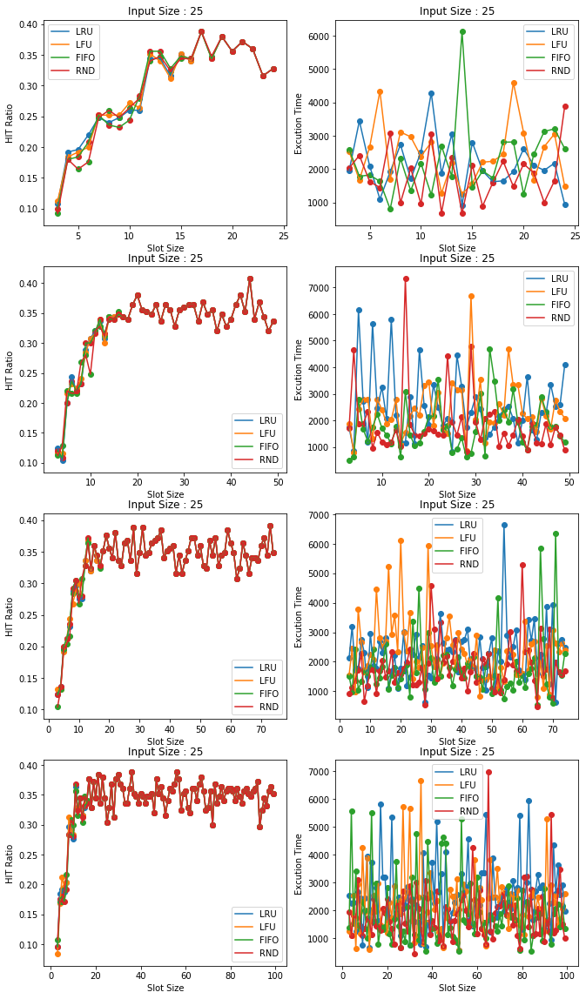

In [157]:
visualize(input_size = 25, input_max_size = 25)